In [2]:
# Transfer learning usingn SCANVI (scArches) - Python

## Install scArches following the instructions detailed here: https://scarches.readthedocs.io/en/latest/installation.html

## Load packages
import scanpy as sc
import torch
import scarches as sca
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import anndata 

# oload torch

# sca.zenodo.download_model("https://zenodo.org/records/6962901/files/scarches_SCANVI_core_GBmap.zip","./scraches_down",make_dir=True)
# exit()

# x = torch.load(
#     "/Users/carbs/Downloads/Spatial_Meta/scarchesFiles/scarches_SCANVI_core_GBmap/model_params.pt",
#     map_location=torch.device("cpu"),
# )
# # it appears its state dict directly save it as a model
# # this is full state dict directly
# # step one back and
# p = {}
# p["model_state_dict"] = x

# torch.save(
#     p,
#     "/Users/carbs/Downloads/Spatial_Meta/scarchesFiles/scarches_SCANVI_core_GBmap/model.pt",
# )


def read_and_qc(sample_name, path="./visium/"):
    r"""This function reads the data for one 10X spatial experiment into the anndata object.
    It also calculates QC metrics. Modify this function if required by your workflow.

    :param sample_name: Name of the sample
    :param path: path to data
    """

    adata = sc.read_visium(
        path + str(sample_name) + "/outs/",
        library_id=sample_name,
        count_file="filtered_feature_bc_matrix.h5",
    )
    adata.obs["sample"] = sample_name
    adata.var["SYMBOL"] = adata.var_names
    adata.var_names_make_unique()  # CHANGE THIS PART OF THE CODE TO ALLOW GENE SYMBOL

    # Calculate QC metrics
    sc.pp.calculate_qc_metrics(adata, inplace=True)
    adata.var["MT_gene"] = [gene.startswith("mt-") for gene in adata.var["SYMBOL"]]
    # remove MT genes for spatial mapping (keeping their counts in the object)
    adata.obsm["MT"] = adata[:, adata.var["MT_gene"].values].X.toarray()
    adata = adata[:, ~adata.var["MT_gene"].values]

    # add sample name to obs names
    adata.obs["sample"] = [str(i) for i in adata.obs["sample"]]
    adata.obs_names = adata.obs["sample"] + "_" + adata.obs_names
    adata.obs.index.name = "spot_id"

    return adata

# load visium data

target_adata_A = read_and_qc(
    "A-AK40374-AK40375_225GY5LT3", path="/Volumes/Elements/luks_visium/"
)
target_adata_B = read_and_qc(
    "B-AK40376-AK40377_225GY5LT3", path="/Volumes/Elements/luks_visium/"
)

target_adata_C = read_and_qc(
    "C-AK40378-AK40379_225GY5LT3", path="/Volumes/Elements/luks_visium/"
)
target_adata_D = read_and_qc(
    "D-AK40380-AK40381_225GY5LT3", path="/Volumes/Elements/luks_visium/"
)


print(target_adata_A)
print(target_adata_B)
print(target_adata_C)
print(target_adata_D)




/Users/carbs/miniforge3/envs/ai/lib/python3.11/site-packages/anndata/_core/anndata.py:1908: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/carbs/miniforge3/envs/ai/lib/python3.11/site-packages/anndata/_core/anndata.py:1908: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
/var/folders/wk/1gf2_m552kl8lnst82lpjrn00000gn/T/ipykernel_64442/1914231117.py:60: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["sample"] = [str(i) for i in adata.obs["sample"]]
/Users/carbs/miniforge3/envs/ai/lib/python3.11/site-packages/anndata/_core/anndata.py:1908: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_

AnnData object with n_obs × n_vars = 2565 × 17943
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'SYMBOL', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'MT_gene'
    uns: 'spatial'
    obsm: 'spatial', 'MT'
AnnData object with n_obs × n_vars = 849 × 17943
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'SYMBOL', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_count

/var/folders/wk/1gf2_m552kl8lnst82lpjrn00000gn/T/ipykernel_64442/1914231117.py:60: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["sample"] = [str(i) for i in adata.obs["sample"]]


In [5]:
#combine the data
target_adata = target_adata_A.concatenate(
    target_adata_B, target_adata_C, target_adata_D, batch_key="sample", batch_categories=["A", "B", "C", "D"]
)

/var/folders/wk/1gf2_m552kl8lnst82lpjrn00000gn/T/ipykernel_64442/862209017.py:2: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  target_adata = target_adata_A.concatenate(


In [8]:
target_adata.obs

,in_tissue,array_row,array_col,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes
spot_id,,,,,,,,,,,,
A-AK40374-AK40375_225GY5LT3_AAACAACGAATAGTTC-1-A,1,0,16,A,3273,8.093768,5353.0,8.585599,10.293293,15.281151,22.940407,38.501775
A-AK40374-AK40375_225GY5LT3_AAACACCAATAACTGC-1-A,1,59,19,A,3273,8.093768,6295.0,8.747670,18.649722,24.241461,31.818904,46.783161
A-AK40374-AK40375_225GY5LT3_AAACAGAGCGACTCCT-1-A,1,14,94,A,4100,8.318986,7777.0,8.959055,12.254083,17.281728,24.431015,38.485277
A-AK40374-AK40375_225GY5LT3_AAACAGCTTTCAGAAG-1-A,1,43,9,A,1878,7.538495,2502.0,7.825245,11.670663,17.825739,26.298961,44.924061
A-AK40374-AK40375_225GY5LT3_AAACAGGGTCTATATT-1-A,1,47,13,A,1323,7.188413,1664.0,7.417581,13.161058,19.711538,31.730769,50.540865
...,...,...,...,...,...,...,...,...,...,...,...,...
D-AK40380-AK40381_225GY5LT3_TTGTTAGCAAATTCGA-1-D,1,22,42,D,5021,8.521584,11946.0,9.388235,13.661477,18.801272,25.749205,38.858195
D-AK40380-AK40381_225GY5LT3_TTGTTCTAGATACGCT-1-D,1,21,3,D,4780,8.472405,10746.0,9.282382,12.953657,18.416155,25.414108,38.619021
D-AK40380-AK40381_225GY5LT3_TTGTTGTGTGTCAAGA-1-D,1,31,77,D,5624,8.634976,14777.0,9.600895,13.121743,18.149827,25.045679,38.106517


/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_anndata.py:906: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_anndata.py:906: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


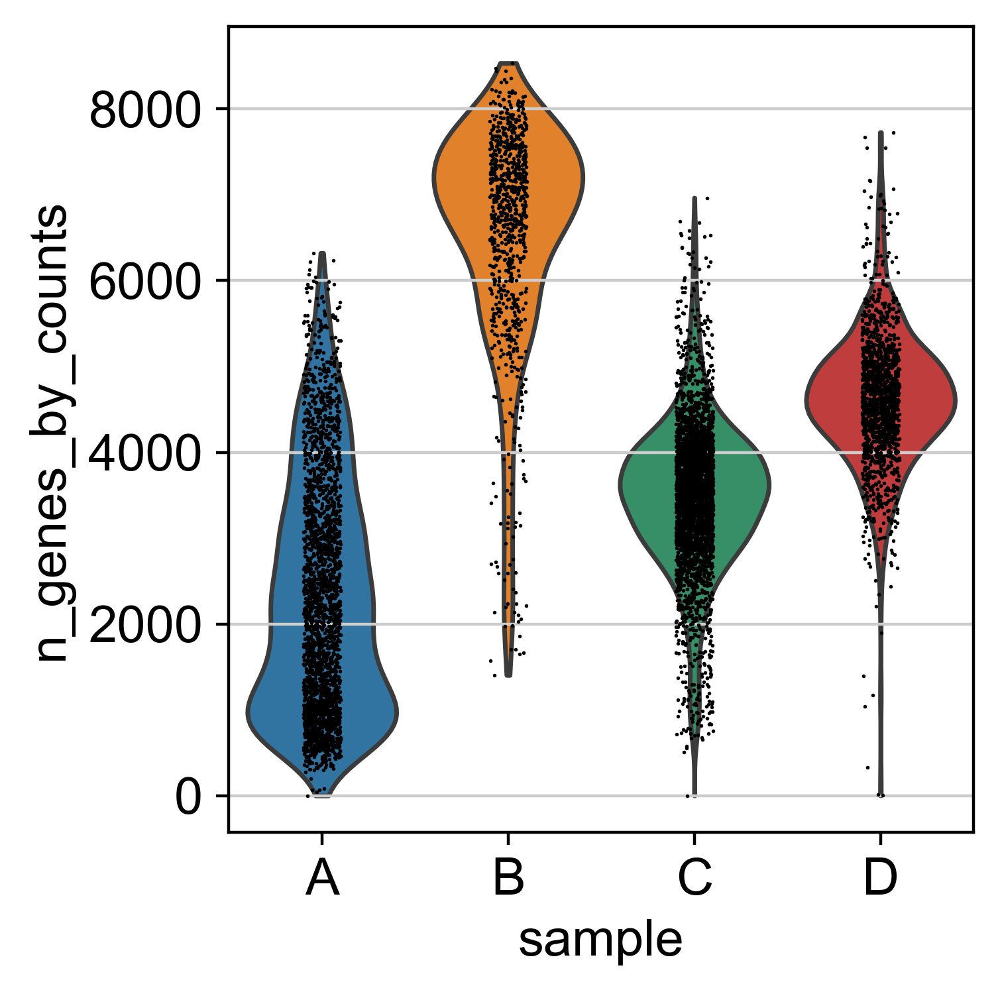

In [9]:
#violon plot
sc.pl.violin(target_adata, "n_genes_by_counts", groupby="sample")



In [4]:
target_adata.X

<4781x17943 sparse matrix of type '<class 'numpy.float32'>'
	with 18374313 stored elements in Compressed Sparse Row format>

In [3]:
sca.__version__

'0.5.10'

In [11]:
## Load and prepare your data
# target_adata = sc.read('path/to/your/data.h5ad') # read your data using scanpy (load AnnData object)
ref_path_converted = (
    "/Users/carbs/Downloads/Spatial_Meta/scraches_down_converted_fromlegacy/"
)
source_adata = sc.read(
    "/Users/carbs/Downloads/Spatial_Meta/scarchesFiles/scarches_core_GBmap.h5ad"
)



# #convert convert_legacy_save

# sca.models.SCANVI.convert_legacy_save(ref_path, ref_path_coberted)

vae = sca.models.SCANVI.load(ref_path_converted, source_adata)  # unzip scarches-SCANVI_GBmap.zip
cell_type_key = "CellID"






INFO     File /Users/carbs/Downloads/Spatial_Meta/scraches_down_converted_fromlegacy/model.pt already downloaded   
mappinggggg ['Bhaduri2020' 'Couturier2020' 'Darmanis2017' 'Goswami2019' 'Johnson2020'
 'Mathewson2021' 'Neftel2019_10x' 'Neftel2019_smart' 'Pombo2021'
 'Richards2021' 'Sankowski2019' 'Wang2019' 'Wang2020' 'Wu2020' 'Yu2020'
 'Yuan2018' 'Zhao2020']
mappinggggg extend_categories False
searching for Bhaduri2020
searching for Couturier2020
searching for Darmanis2017
searching for Goswami2019
searching for Johnson2020
searching for Mathewson2021
searching for Neftel2019_10x
searching for Neftel2019_smart
searching for Pombo2021
searching for Richards2021
searching for Sankowski2019
searching for Wang2019
searching for Wang2020
searching for Wu2020
searching for Yu2020
searching for Yuan2018
searching for Zhao2020
mappinggggg ['AC-like' 'Astrocyte' 'B cell' 'CD4/CD8' 'DC' 'Endothelial' 'MES-like'
 'Mast' 'Mono' 'Mural cell' 'NK' 'NPC-like' 'Neuron' 'OPC' 'OPC-like'
 'Oligodendro

In [6]:
vae.unlabeled_category_

'Unknown'

In [12]:
source_adata.obs

,author,patient,method,CellID,_scvi_batch,_scvi_labels,_scvi_local_l_mean,_scvi_local_l_var
PJ017_0,Yuan2018,PJ017,cell,MES-like,15,6,6.441088,0.417351
PJ017_1,Yuan2018,PJ017,cell,OPC-like,15,14,6.441088,0.417351
PJ017_2,Yuan2018,PJ017,cell,TAM-BDM,15,18,6.441088,0.417351
PJ017_3,Yuan2018,PJ017,cell,MES-like,15,6,6.441088,0.417351
PJ017_4,Yuan2018,PJ017,cell,AC-like,15,0,6.441088,0.417351
...,...,...,...,...,...,...,...,...
E100_GEX_TTTGTCACATGCAATC-1,Mathewson2021,E100,cell,CD4/CD8,5,3,6.911591,0.410996
E100_GEX_TTTGTCAGTAGAGCTG-1,Mathewson2021,E100,cell,CD4/CD8,5,3,6.911591,0.410996
E100_GEX_TTTGTCAGTATCGCAT-1,Mathewson2021,E100,cell,CD4/CD8,5,3,6.911591,0.410996
E100_GEX_TTTGTCATCTGTCTCG-1,Mathewson2021,E100,cell,CD4/CD8,5,3,6.911591,0.410996


In [13]:
target_adata.obs

,in_tissue,array_row,array_col,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes
spot_id,,,,,,,,,,,,
A-AK40374-AK40375_225GY5LT3_AAACAACGAATAGTTC-1-A,1,0,16,A,3273,8.093768,5353.0,8.585599,10.293293,15.281151,22.940407,38.501775
A-AK40374-AK40375_225GY5LT3_AAACACCAATAACTGC-1-A,1,59,19,A,3273,8.093768,6295.0,8.747670,18.649722,24.241461,31.818904,46.783161
A-AK40374-AK40375_225GY5LT3_AAACAGAGCGACTCCT-1-A,1,14,94,A,4100,8.318986,7777.0,8.959055,12.254083,17.281728,24.431015,38.485277
A-AK40374-AK40375_225GY5LT3_AAACAGCTTTCAGAAG-1-A,1,43,9,A,1878,7.538495,2502.0,7.825245,11.670663,17.825739,26.298961,44.924061
A-AK40374-AK40375_225GY5LT3_AAACAGGGTCTATATT-1-A,1,47,13,A,1323,7.188413,1664.0,7.417581,13.161058,19.711538,31.730769,50.540865
...,...,...,...,...,...,...,...,...,...,...,...,...
D-AK40380-AK40381_225GY5LT3_TTGTTAGCAAATTCGA-1-D,1,22,42,D,5021,8.521584,11946.0,9.388235,13.661477,18.801272,25.749205,38.858195
D-AK40380-AK40381_225GY5LT3_TTGTTCTAGATACGCT-1-D,1,21,3,D,4780,8.472405,10746.0,9.282382,12.953657,18.416155,25.414108,38.619021
D-AK40380-AK40381_225GY5LT3_TTGTTGTGTGTCAAGA-1-D,1,31,77,D,5624,8.634976,14777.0,9.600895,13.121743,18.149827,25.045679,38.106517


In [14]:
target_adata.layers[
    "counts"
] = target_adata.X.copy()  # target_adata.X must be where your raw counts are stored


# target_adata.obs[cell_type_key] = vae.unlabeled_category_


In [15]:
target_adata.var

,gene_ids,feature_types,genome,SYMBOL,MT_gene,n_cells_by_counts-A,mean_counts-A,log1p_mean_counts-A,pct_dropout_by_counts-A,total_counts-A,...,log1p_mean_counts-C,pct_dropout_by_counts-C,total_counts-C,log1p_total_counts-C,n_cells_by_counts-D,mean_counts-D,log1p_mean_counts-D,pct_dropout_by_counts-D,total_counts-D,log1p_total_counts-D
SAMD11,ENSG00000187634,Gene Expression,GRCh38,SAMD11,False,17,0.006628,0.006606,99.337232,17.0,...,0.011878,98.805147,39.0,3.688879,14,0.010547,0.010492,99.077126,16.0,2.833213
NOC2L,ENSG00000188976,Gene Expression,GRCh38,NOC2L,False,753,0.413645,0.346172,70.643275,1061.0,...,0.410762,61.029412,1658.0,7.413970,726,0.655241,0.503946,52.142386,994.0,6.902743
KLHL17,ENSG00000187961,Gene Expression,GRCh38,KLHL17,False,81,0.031579,0.031091,96.842105,81.0,...,0.071237,92.800245,241.0,5.488938,156,0.105471,0.100272,89.716546,160.0,5.081404
PLEKHN1,ENSG00000187583,Gene Expression,GRCh38,PLEKHN1,False,5,0.001949,0.001947,99.805068,5.0,...,0.003059,99.724265,10.0,2.397895,3,0.001978,0.001976,99.802241,3.0,1.386294
PERM1,ENSG00000187642,Gene Expression,GRCh38,PERM1,False,11,0.004288,0.004279,99.571150,11.0,...,0.006718,99.325980,22.0,3.135494,3,0.001978,0.001976,99.802241,3.0,1.386294
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TSPY1,ENSG00000258992,Gene Expression,GRCh38,TSPY1,False,0,0.000000,0.000000,100.000000,0.0,...,0.000000,100.000000,0.0,0.000000,0,0.000000,0.000000,100.000000,0.0,0.000000
USP9Y,ENSG00000114374,Gene Expression,GRCh38,USP9Y,False,35,0.013645,0.013553,98.635478,35.0,...,0.067521,93.259804,228.0,5.433722,159,0.111404,0.105624,89.518787,169.0,5.135798
DDX3Y,ENSG00000067048,Gene Expression,GRCh38,DDX3Y,False,221,0.093567,0.089445,91.384016,240.0,...,0.386079,62.377451,1538.0,7.338888,712,0.649967,0.500755,53.065260,986.0,6.894670
TMSB4Y,ENSG00000154620,Gene Expression,GRCh38,TMSB4Y,False,4,0.001559,0.001558,99.844055,4.0,...,0.013390,98.651961,44.0,3.806663,41,0.027027,0.026668,97.297297,41.0,3.737670


In [16]:
source_adata.var

,feature_types,genome,highly_variable,means,dispersions,dispersions_norm,highly_variable_nbatches,highly_variable_intersection
TRIM63,Gene Expression,unknown,True,0.001340,0.407240,0.454033,6,False
CCP110,Gene Expression,unknown,True,0.144074,0.720043,0.438280,10,False
CCDC186,Gene Expression,unknown,True,0.137050,0.570207,0.270854,8,False
RTN1,Gene Expression,unknown,True,0.135925,0.771399,0.519078,11,False
RHOG,Gene Expression,unknown,True,0.435874,0.769815,-0.000273,6,False
...,...,...,...,...,...,...,...,...
OBSCN-AS1,Gene Expression,unknown,True,0.002452,0.254650,0.150558,6,False
H4C4,Gene Expression,unknown,True,0.002724,0.301861,0.195486,6,False
HOATZ,Gene Expression,unknown,True,0.017586,0.628281,0.806285,7,False
LINC02694,Gene Expression,unknown,True,0.002845,0.262499,0.326861,6,False


In [17]:
#check if matching var  bbtween source and target
print( len(set(source_adata.var.index) - set(target_adata.var.index) ))



481


In [18]:

map2 = pd.read_csv(
        "/Users/carbs/Downloads/Spatial_Meta/visium/A-AK40374-AK40375_225GY5LT3/SPATIAL_RNA_COUNTER_CS/SPATIAL_RNA_COUNTER/_TARGETED_ANALYZER/CALCULATE_TARGETED_METRICS/fork0/join-u63f66a1acf/files/per_feature_metrics_csv.csv"
    )

# keep only colums with name feature_type,feature_id,feature_name,
mapp2 = map2[["feature_type", "feature_id", "feature_name"]]
# rename columns
mapp2.columns = ["feature_type", "gene_id", "gene_name"]

# transfrom  b'ENSG00000130203' to ENSG00000130203 by removing b' and '
mapp2["gene_id"] = mapp2["gene_id"].str[2:-1]


diff_gene_names = list(set(source_adata.var.index) - set(target_adata.var.index))
print(len(diff_gene_names))
#find in gene set
gene_setttt = pd.read_csv("./genes_for_mapping_ok.csv")
gene_setttt.head()

for gene in diff_gene_names:
    #find index in gene_symbols
    # print(gene)
    ens_name = gene_setttt[gene_setttt['gene_symbols'] == gene]['Unnamed: 0'].values[0]
    # print(ens_name)

    #find it in map2

    lookup = mapp2[mapp2['gene_id'] == ens_name]['gene_name']
    #check if exists
    if lookup.empty:
        print('not found in map2', gene, ens_name)
    else:
        my_name = lookup.values[0]
        # print('found in map2', my_name)

        #rename gene in target_adata to my_name

        #chekc if genes name different
        if gene != my_name:
            print('different gene names', gene, my_name)

            target_adata.var.index = target_adata.var.index.str.replace(my_name, gene)

            
            print('replaced', my_name, gene)

dif_After_gene_names = list(set(source_adata.var.index) - set(target_adata.var.index))
before_gene_names = list(set(source_adata.var.index) - set(diff_gene_names))
print("before", len(before_gene_names))
print("after", len(dif_After_gene_names))

/var/folders/wk/1gf2_m552kl8lnst82lpjrn00000gn/T/ipykernel_64442/508782695.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mapp2["gene_id"] = mapp2["gene_id"].str[2:-1]


481
different gene names LL22NC03-2H8.5 AC245060.5
replaced AC245060.5 LL22NC03-2H8.5
different gene names TAMALIN GRASP
replaced GRASP TAMALIN
not found in map2 BCYRN1 ENSG00000236824
not found in map2 RP11-849I19.1 ENSG00000262280
different gene names H4C8 HIST1H4H
replaced HIST1H4H H4C8
different gene names CFAP251 WDR66
replaced WDR66 CFAP251
different gene names MROCKI LINC01268
replaced LINC01268 MROCKI
different gene names H2BC21 HIST2H2BE
replaced HIST2H2BE H2BC21
different gene names RP11-693J15.5 LINC02397
replaced LINC02397 RP11-693J15.5
different gene names RP11-1275H24.2 AC092171.4
replaced AC092171.4 RP11-1275H24.2
different gene names H2AC16 HIST1H2AL
replaced HIST1H2AL H2AC16
different gene names RP11-305L7.1 AL158071.3
replaced AL158071.3 RP11-305L7.1
different gene names MIR9-1HG C1orf61
replaced C1orf61 MIR9-1HG
not found in map2 TTTY15 ENSG00000233864
different gene names RP11-701P16.2 AC084871.1
replaced AC084871.1 RP11-701P16.2
not found in map2 VTRNA2-1 ENSG00000

In [19]:
diff_gene_names = list(set(source_adata.var.index) - set(target_adata.var.index))
print(len(diff_gene_names))

print(diff_gene_names)

#svae names to txt
with open("source_adatavar.txt", "w") as output:
    for row in source_adata.var.index:
        output.write(str(row) + '\n')


with open("target_adatavar.txt", "w") as output:
    for row in target_adata.var.index:
        output.write(str(row) + '\n')



428
['LL22NC03-2H8.5', 'LINC01094', 'BCL11B', 'APOL2', 'LGALS9', 'SNHG18', 'BCYRN1', 'RP11-849I19.1', 'AGAP2-AS1', 'TUBB4B', 'HOTAIRM1', 'MROCKI', 'PTPRCAP', 'PPIAL4G', 'ZBTB20-AS2', 'UTP14C', 'AC092484.1', 'RP11-693J15.5', 'HIBCH', 'RP11-1275H24.2', 'H2AC16', 'IGLC2', 'LINC01116', 'LINC00467', 'RN7SL832P', 'CKS1B', 'MPRIP-AS1', 'HSPA12A', 'RP11-305L7.1', 'PTPRD-AS1', 'TTTY15', 'RP11-701P16.2', 'HOXB-AS1', 'VTRNA2-1', 'ATP2B1-AS1', 'YBX3', 'LINC00706', 'DSE', 'KANSL1-AS1', 'CDC42EP3', 'MCM3AP-AS1', 'LINC01445', 'RGS10', 'LINC00265', 'AC002331.1', 'MINCR', 'PLAC8', 'ZBED6', 'ZNF812P', 'MIR3945HG', 'RP11-242D8.1', 'GBP3', 'RP11-480C22.1', 'H2AC19', 'MIAT', 'RP11-758H9.2', 'CRNDE', 'AP005530.2', 'MIR219A2', 'MIR503HG', 'RUNX2', 'XCL2', 'FAM215B', 'CXCL6', 'RASA4', 'METTL15', 'LINC00844', 'AC069363.1', 'MT-ND6', 'ARL6IP1', 'SIGLEC9', 'ACTA1', 'CYTOR', 'FAM183A', 'CATSPER2', 'LINC00239', 'MIR155HG', 'RP11-51J9.5', 'DLGAP1-AS1', 'SDCBP2-AS1', 'SERTAD4-AS1', 'CALCB', 'LINC01551', 'RP11-386I14

In [20]:
target_adata.var

,gene_ids,feature_types,genome,SYMBOL,MT_gene,n_cells_by_counts-A,mean_counts-A,log1p_mean_counts-A,pct_dropout_by_counts-A,total_counts-A,...,log1p_mean_counts-C,pct_dropout_by_counts-C,total_counts-C,log1p_total_counts-C,n_cells_by_counts-D,mean_counts-D,log1p_mean_counts-D,pct_dropout_by_counts-D,total_counts-D,log1p_total_counts-D
SAMD11,ENSG00000187634,Gene Expression,GRCh38,SAMD11,False,17,0.006628,0.006606,99.337232,17.0,...,0.011878,98.805147,39.0,3.688879,14,0.010547,0.010492,99.077126,16.0,2.833213
NOC2L,ENSG00000188976,Gene Expression,GRCh38,NOC2L,False,753,0.413645,0.346172,70.643275,1061.0,...,0.410762,61.029412,1658.0,7.413970,726,0.655241,0.503946,52.142386,994.0,6.902743
KLHL17,ENSG00000187961,Gene Expression,GRCh38,KLHL17,False,81,0.031579,0.031091,96.842105,81.0,...,0.071237,92.800245,241.0,5.488938,156,0.105471,0.100272,89.716546,160.0,5.081404
PLEKHN1,ENSG00000187583,Gene Expression,GRCh38,PLEKHN1,False,5,0.001949,0.001947,99.805068,5.0,...,0.003059,99.724265,10.0,2.397895,3,0.001978,0.001976,99.802241,3.0,1.386294
PERM1,ENSG00000187642,Gene Expression,GRCh38,PERM1,False,11,0.004288,0.004279,99.571150,11.0,...,0.006718,99.325980,22.0,3.135494,3,0.001978,0.001976,99.802241,3.0,1.386294
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TSPY1,ENSG00000258992,Gene Expression,GRCh38,TSPY1,False,0,0.000000,0.000000,100.000000,0.0,...,0.000000,100.000000,0.0,0.000000,0,0.000000,0.000000,100.000000,0.0,0.000000
USP9Y,ENSG00000114374,Gene Expression,GRCh38,USP9Y,False,35,0.013645,0.013553,98.635478,35.0,...,0.067521,93.259804,228.0,5.433722,159,0.111404,0.105624,89.518787,169.0,5.135798
DDX3Y,ENSG00000067048,Gene Expression,GRCh38,DDX3Y,False,221,0.093567,0.089445,91.384016,240.0,...,0.386079,62.377451,1538.0,7.338888,712,0.649967,0.500755,53.065260,986.0,6.894670
TMSB4Y,ENSG00000154620,Gene Expression,GRCh38,TMSB4Y,False,4,0.001559,0.001558,99.844055,4.0,...,0.013390,98.651961,44.0,3.806663,41,0.027027,0.026668,97.297297,41.0,3.737670


In [21]:

def subset_and_pad_adata(gene_set, adata):
    """
    This function uses a gene list provided as a Pandas dataframe with gene symbols and
    Ensembl IDs and subsets a larger Anndata object to only the genes in this list. If
    Not all genes are found in the AnnData object, then zero-padding is performed.
    """
    # Example inputs:
    # genes_filename = '/storage/groups/ml01/workspace/hlca_lisa.sikkema_malte.luecken/genes_for_mapping.csv'
    # data_filename = '/storage/groups/ml01/workspace/hlca_lisa.sikkema_malte.luecken/ready/adams.h5ad'
    # gene_set = pd.read_csv(genes_filename)
    # adata = sc.read(data_filename)

    # Prep objects
    if 'gene_symbols' in gene_set.columns:
        gene_set.index = gene_set['gene_symbols']

    else:
        raise ValueError('The input gene list was not of the expected type!\n'
                         'Gene symbols and ensembl IDs are expected in column names:\n'
                         '\t`gene_symbols` and `Unnamed: 0`')

    # Subset adata object
    common_genes = [gene for gene in gene_set['gene_symbols'].values if gene in adata.var_names]
    if len(common_genes) == 0:
        print("WARNING: YOU SHOULD PROBABLY SWITCH YOUR ADATA.VAR INDEX COLUMN TO GENE NAMES"
                  " RATHER THAN IDS! No genes were recovered.")
        return

    adata_sub = adata[:,common_genes].copy()

    # Pad object with 0 genes if needed
    if len(common_genes) < len(gene_set):
        diff = len(gene_set) - len(common_genes)
        print(f'not all genes were recovered, filling in 0 counts for {diff} missing genes...')

        #get missing genes
        miss = gene_set[~gene_set['gene_symbols'].isin(common_genes)]
        print(miss)
        
        # Genes to pad with
        genes_to_add = set(gene_set['gene_symbols'].values).difference(set(adata_sub.var_names))
        genes_to_add = list(genes_to_add)
        new_var = gene_set.loc[genes_to_add]
        
        if 'Unnamed: 0' in new_var.columns:
            # Assumes the unnamed column are ensembl values
            new_var['ensembl'] = new_var['Unnamed: 0']
            del new_var['Unnamed: 0']

        df_padding = pd.DataFrame(data=np.zeros((adata_sub.shape[0],len(genes_to_add))), index=adata_sub.obs_names, columns=new_var.index)
        adata_padding = sc.AnnData(df_padding, var=new_var)
        
        # Concatenate object
        adata_sub = anndata.concat([adata_sub, adata_padding], axis=1, join='outer', index_unique=None, merge='unique')

    # Ensure ensembl IDs are available
    adata_sub.var['ensembl'] = gene_set['Unnamed: 0']

    return adata_sub

gene_set = pd.read_csv("./genes_for_mapping_ok.csv")
#save gene set as csv

gene_set.head()



target_adata = subset_and_pad_adata(gene_set, target_adata)

not all genes were recovered, filling in 0 counts for 428 missing genes...
                   Unnamed: 0 gene_symbols
gene_symbols                              
CKS2          ENSG00000123975         CKS2
ARL6IP1       ENSG00000170540      ARL6IP1
RCOR2         ENSG00000167771        RCOR2
RGS10         ENSG00000148908        RGS10
BOLA2B        ENSG00000169627       BOLA2B
...                       ...          ...
MANEA-DT      ENSG00000261366     MANEA-DT
H2AC19        ENSG00000272196       H2AC19
ATP2B1-AS1    ENSG00000271614   ATP2B1-AS1
H2AC16        ENSG00000276903       H2AC16
OBSCN-AS1     ENSG00000162913    OBSCN-AS1

[428 rows x 2 columns]


In [22]:
difff = list(set(source_adata.var.index) - set(target_adata.var.index))
difff

[]

In [23]:
#get gene symbols from source adata
source_adata.var.index


Index(['TRIM63', 'CCP110', 'CCDC186', 'RTN1', 'RHOG', 'SGO1', 'TPM2', 'CKS2',
       'ARL6IP1', 'RCOR2',
       ...
       'GUCY1A1', 'PLAAT1', 'PPDPFL', 'H2AC16', 'H4C1', 'OBSCN-AS1', 'H4C4',
       'HOATZ', 'LINC02694', 'MUCL3'],
      dtype='object', length=5000)

In [24]:
target_adata.var.index

Index(['TRIM63', 'CCP110', 'CCDC186', 'RTN1', 'RHOG', 'SGO1', 'TPM2', 'TNRC6C',
       'ZNF559', 'ANKAR',
       ...
       'CAPN10-DT', 'SLC16A1-AS1', 'OVOL1', 'RP11-473M20.16', 'CKS2',
       'MIR99AHG', 'TUBB2B', 'AC018647.3', 'COBL', 'RPS6KA5'],
      dtype='object', length=5000)

In [25]:
source_adata.obs_keys  


<bound method AnnData.obs_keys of AnnData object with n_obs × n_vars = 338564 × 5000
    obs: 'author', 'patient', 'method', 'CellID', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var'
    var: 'feature_types', 'genome', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: '_scvi', 'hvg', '_scvi_uuid', '_scvi_manager_uuid'
    layers: 'counts'>

In [26]:
adata_query = sca.models.SCANVI.prepare_query_anndata(
    adata=target_adata, reference_model=ref_path_converted, inplace=False
)

#this fixes the indexes and sortst them coreclt

INFO     File /Users/carbs/Downloads/Spatial_Meta/scraches_down_converted_fromlegacy/model.pt already downloaded   
INFO     Found 100.0% reference vars in query data.                                                                


In [27]:
adata_query.var.index

Index(['TRIM63', 'CCP110', 'CCDC186', 'RTN1', 'RHOG', 'SGO1', 'TPM2', 'CKS2',
       'ARL6IP1', 'RCOR2',
       ...
       'GUCY1A1', 'PLAAT1', 'PPDPFL', 'H2AC16', 'H4C1', 'OBSCN-AS1', 'H4C4',
       'HOATZ', 'LINC02694', 'MUCL3'],
      dtype='object', length=5000)

In [28]:
source_adata.var.index

Index(['TRIM63', 'CCP110', 'CCDC186', 'RTN1', 'RHOG', 'SGO1', 'TPM2', 'CKS2',
       'ARL6IP1', 'RCOR2',
       ...
       'GUCY1A1', 'PLAAT1', 'PPDPFL', 'H2AC16', 'H4C1', 'OBSCN-AS1', 'H4C4',
       'HOATZ', 'LINC02694', 'MUCL3'],
      dtype='object', length=5000)

In [46]:
# adata_query.obs["author"] = "Luka_batch_1"

#set author to sample as author is batch key
adata_query.obs["author"] = adata_query.obs["sample"].values




#IMPORTANT IT HAS TO BE THE SAME AS THE SOURCE ADATA JUST TAKE ONE CELL TYPE FROM THE SOURCE ADATA
# it dosent matter since it will be unlabelled
adata_query.obs[cell_type_key] = source_adata.obs[cell_type_key][0]


/var/folders/wk/1gf2_m552kl8lnst82lpjrn00000gn/T/ipykernel_64442/990083152.py:11: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  adata_query.obs[cell_type_key] = source_adata.obs[cell_type_key][0]


In [47]:
adata_query.obs["sample"].values

['A', 'A', 'A', 'A', 'A', ..., 'D', 'D', 'D', 'D', 'D']
Length: 8195
Categories (4, object): ['A', 'B', 'C', 'D']

In [49]:
adata_query.obs.head()

,in_tissue,array_row,array_col,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,author,CellID,_scvi_batch,_scvi_labels
spot_id,,,,,,,,,,,,,,,,
A-AK40374-AK40375_225GY5LT3_AAACAACGAATAGTTC-1-A,1,0,16,A,3273,8.093768,5353.0,8.585599,10.293293,15.281151,22.940407,38.501775,A,MES-like,17,6
A-AK40374-AK40375_225GY5LT3_AAACACCAATAACTGC-1-A,1,59,19,A,3273,8.093768,6295.0,8.747670,18.649722,24.241461,31.818904,46.783161,A,MES-like,17,6
A-AK40374-AK40375_225GY5LT3_AAACAGAGCGACTCCT-1-A,1,14,94,A,4100,8.318986,7777.0,8.959055,12.254083,17.281728,24.431015,38.485277,A,MES-like,17,6
A-AK40374-AK40375_225GY5LT3_AAACAGCTTTCAGAAG-1-A,1,43,9,A,1878,7.538495,2502.0,7.825245,11.670663,17.825739,26.298961,44.924061,A,MES-like,17,6
A-AK40374-AK40375_225GY5LT3_AAACAGGGTCTATATT-1-A,1,47,13,A,1323,7.188413,1664.0,7.417581,13.161058,19.711538,31.730769,50.540865,A,MES-like,17,6


In [135]:
#get count of cells in source adata
source_adata.obs[cell_type_key].value_counts()


CellID
TAM-BDM            61134
TAM-MG             54722
CD4/CD8            54257
AC-like            50847
MES-like           33167
NPC-like           22117
OPC-like           21390
Mono               14215
Oligodendrocyte    12481
DC                  3961
RG                  2807
NK                  2489
Mural cell          1418
B cell              1250
Endothelial          673
Plasma B             572
OPC                  496
Mast                 373
Astrocyte            173
Neuron                22
Name: count, dtype: int64

In [50]:
model = sca.models.SCANVI.load_query_data(
    adata_query, 
    ref_path_converted,
    freeze_dropout = True,
    inplace_subset_query_vars = True  
    # your adata must have the same gene length (5000) and names as the GBmap core (source_adata)
    # `inplace_subset_query_vars = True` will subset and reorder the vars to tarin the model properly
    # In case you want to subet and tidy up your AnnData object beforehand, you can use the file genes_for_mapping.csv uploaded in this repository
    # and the function `subset_and_pad_adata` developed by Lisa Sikkema and Theis team
    # You can find it here: https://github.com/LungCellAtlas/HLCA_reproducibility/blob/main/scripts/preprocessing.py 
)

model._unlabeled_indices = np.arange(target_adata.n_obs)
model._labeled_indices = []
print("Labelled Indices: ", len(model._labeled_indices))
print("Unlabelled Indices: ", len(model._unlabeled_indices))

INFO     File /Users/carbs/Downloads/Spatial_Meta/scraches_down_converted_fromlegacy/model.pt already downloaded   
mappinggggg ['Bhaduri2020' 'Couturier2020' 'Darmanis2017' 'Goswami2019' 'Johnson2020'
 'Mathewson2021' 'Neftel2019_10x' 'Neftel2019_smart' 'Pombo2021'
 'Richards2021' 'Sankowski2019' 'Wang2019' 'Wang2020' 'Wu2020' 'Yu2020'
 'Yuan2018' 'Zhao2020']
mappinggggg extend_categories True
searching for A
not found A in ['Bhaduri2020' 'Couturier2020' 'Darmanis2017' 'Goswami2019' 'Johnson2020'
 'Mathewson2021' 'Neftel2019_10x' 'Neftel2019_smart' 'Pombo2021'
 'Richards2021' 'Sankowski2019' 'Wang2019' 'Wang2020' 'Wu2020' 'Yu2020'
 'Yuan2018' 'Zhao2020']
searching for B
not found B in ['Bhaduri2020' 'Couturier2020' 'Darmanis2017' 'Goswami2019' 'Johnson2020'
 'Mathewson2021' 'Neftel2019_10x' 'Neftel2019_smart' 'Pombo2021'
 'Richards2021' 'Sankowski2019' 'Wang2019' 'Wang2020' 'Wu2020' 'Yu2020'
 'Yuan2018' 'Zhao2020' 'A']
searching for C
not found C in ['Bhaduri2020' 'Couturier2020' 'Dar

/Users/carbs/miniforge3/envs/ai/lib/python3.11/site-packages/scvi/model/_scanvi.py:140: UserWarning: This dataset has some empty cells, this might fail inference.Data should be filtered with `scanpy.pp.filter_cells()`
  library_log_means, library_log_vars = _init_library_size(


In [51]:



surgery_epochs = 500

#USE UDATED  early_stopping_kwargs_surgery 
early_stopping_kwargs_surgery = {
    "early_stopping_monitor": "elbo_train",
    "early_stopping_patience": 10,
    "early_stopping_min_delta": 0.001,
    "plan_kwargs": {"weight_decay": 0.0},
}
model.train(max_epochs=surgery_epochs, **early_stopping_kwargs_surgery,accelerator="cpu")

# model.train(
#     max_epochs=surgery_epochs,
#     train_base_model=False,
#     semisupervised_trainer_kwargs=dict(metrics_to_monitor=["accuracy", "elbo"],
#                                        weight_decay=0,
#                                        early_stopping_kwargs=early_stopping_kwargs_surgery
#                                       ),
#     check_val_every_n_epoch=1
# )

INFO     Training for 500 epochs.                                                                                  


INFO: GPU available: True (mps), used: False
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (mps), used: False
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO:lightning.pytorch.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs
/Users/carbs/miniforge3/envs/ai/lib/python3.11/site-packages/lightning/pytorch/trainer/setup.py:201: UserWarning: MPS available but not used. Set `accelerator` and `devices` using `Trainer(accelerator='mps', devices=1)`.
  rank_zero_warn(


Epoch 500/500: 100%|██████████| 500/500 [21:38<00:00,  2.89s/it, v_num=1, train_loss_step=3.51e+3, train_loss_epoch=3.36e+3]

INFO: `Trainer.fit` stopped: `max_epochs=500` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=500` reached.


Epoch 500/500: 100%|██████████| 500/500 [21:38<00:00,  2.60s/it, v_num=1, train_loss_step=3.51e+3, train_loss_epoch=3.36e+3]


In [53]:
model.registry_

{'scvi_version': '1.0.4',
 'model_name': 'SCANVI',
 'setup_args': {'labels_key': 'CellID',
  'unlabeled_category': 'Unknown',
  'layer': 'counts',
  'batch_key': 'author',
  'size_factor_key': None,
  'categorical_covariate_keys': None,
  'continuous_covariate_keys': None},
 'field_registries': defaultdict(dict,
             {'X': {'data_registry': {'attr_name': 'layers',
                'attr_key': 'counts'},
               'state_registry': {'n_obs': 8195,
                'n_vars': 5000,
                'column_names': array(['TRIM63', 'CCP110', 'CCDC186', 'RTN1', 'RHOG', 'SGO1', 'TPM2', ...,
                       'H2AC16', 'H4C1', 'OBSCN-AS1', 'H4C4', 'HOATZ', 'LINC02694',
                       'MUCL3'], dtype=object)},
               'summary_stats': {'n_vars': 5000, 'n_cells': 8195}},
              'batch': {'data_registry': {'attr_name': 'obs',
                'attr_key': '_scvi_batch'},
               'state_registry': {'categorical_mapping': array(['Bhaduri2020', 'Couturier20

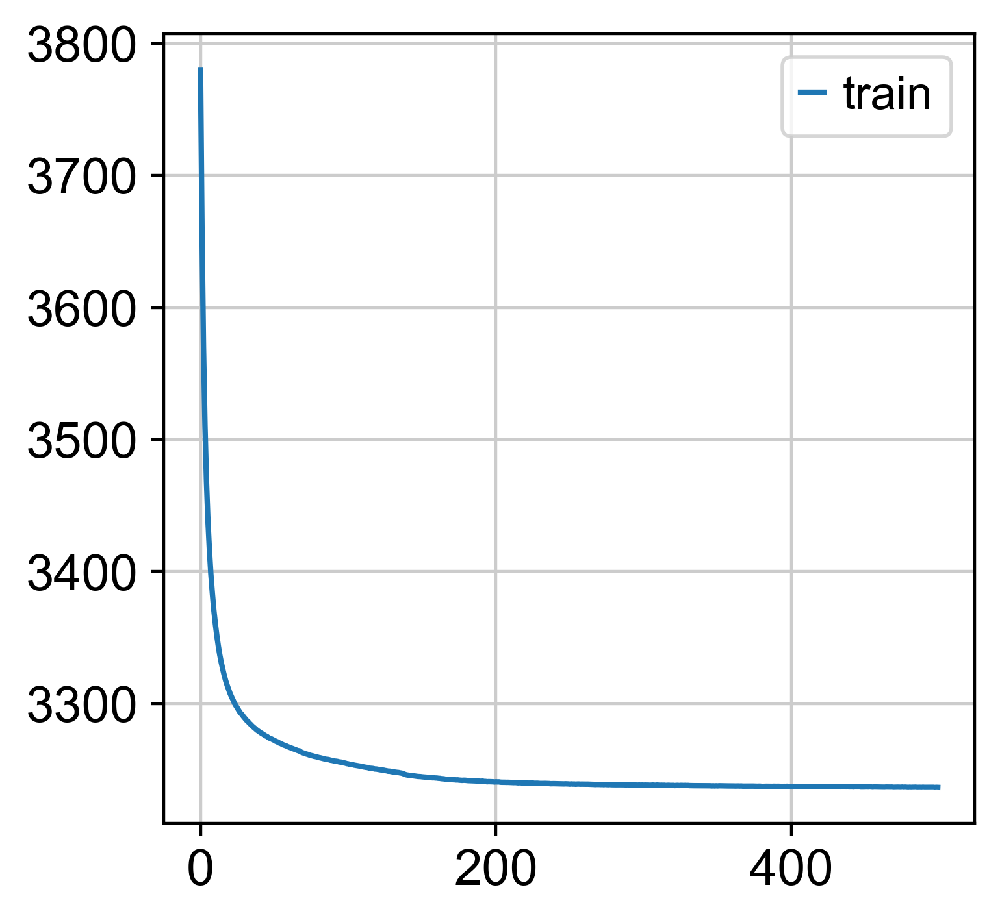

In [54]:
#plot training
model.history["elbo_train"]


plt.plot(model.history["elbo_train"], label="train")
plt.legend()
plt.show()





In [55]:
#save model
model.save("scarches_SCANVI_core_GBmap_surgeryABCD", overwrite=True)

In [ ]:
#load model
# model = sca.models.SCANVI.load("scarches_SCANVI_core_GBmap_surgeryABCD", target_adata)


In [56]:
query_latent = sc.AnnData(model.get_latent_representation())
#add metadata to my latent representation
query_latent.obs = adata_query.obs.loc[adata_query.obs.index, :]
query_latent.obs['predictions'] = model.predict() # get predictions of cell anotation from the model


In [58]:
query_latent.obs["ref_or_query"] = "query"
source_adata.obs["ref_or_query"] = "ref"

/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


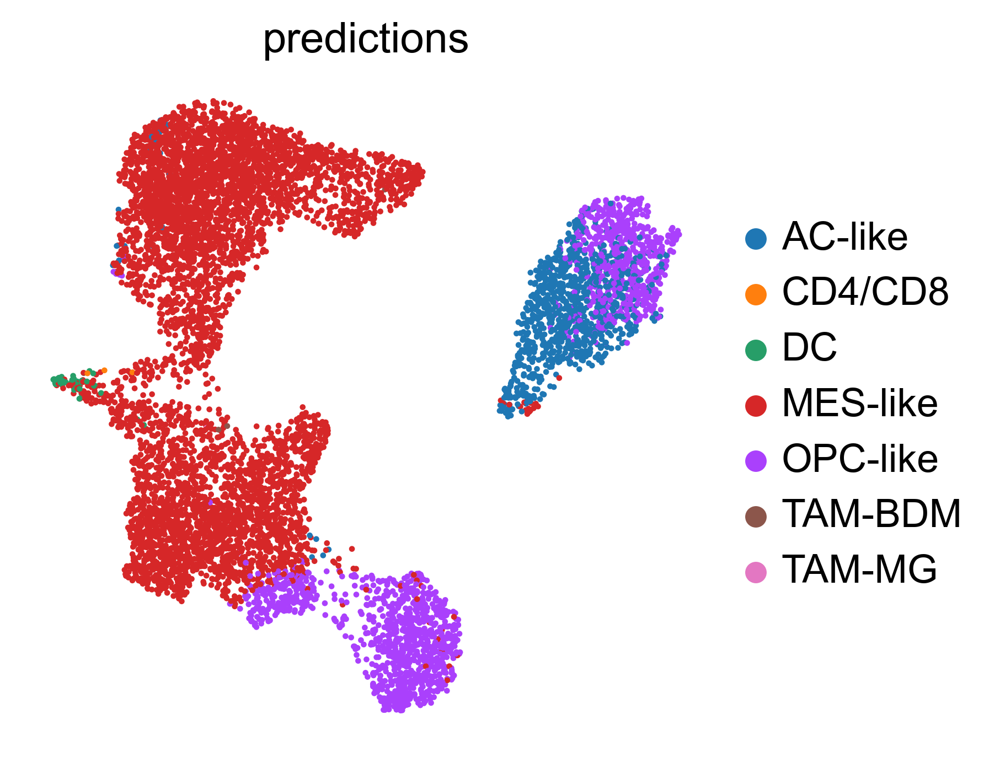

In [59]:
## Visualization
sc.pp.neighbors(query_latent)
sc.tl.leiden(query_latent)
sc.tl.umap(query_latent)



/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


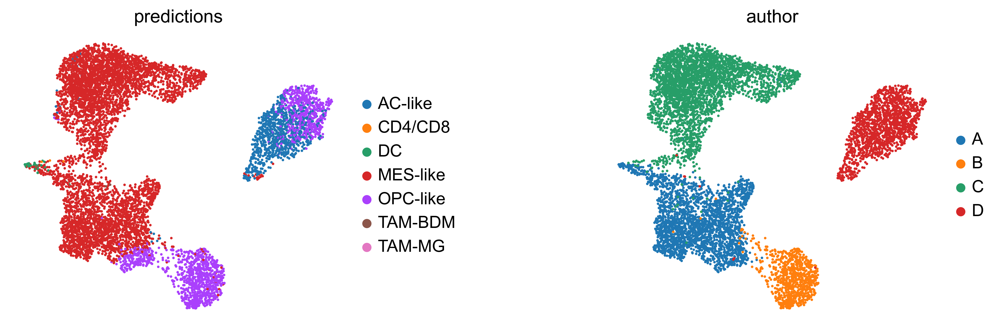

In [60]:
sc.pl.umap(query_latent,
           color=['predictions','author'],
           frameon=False,
           wspace=0.6,
           )

/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


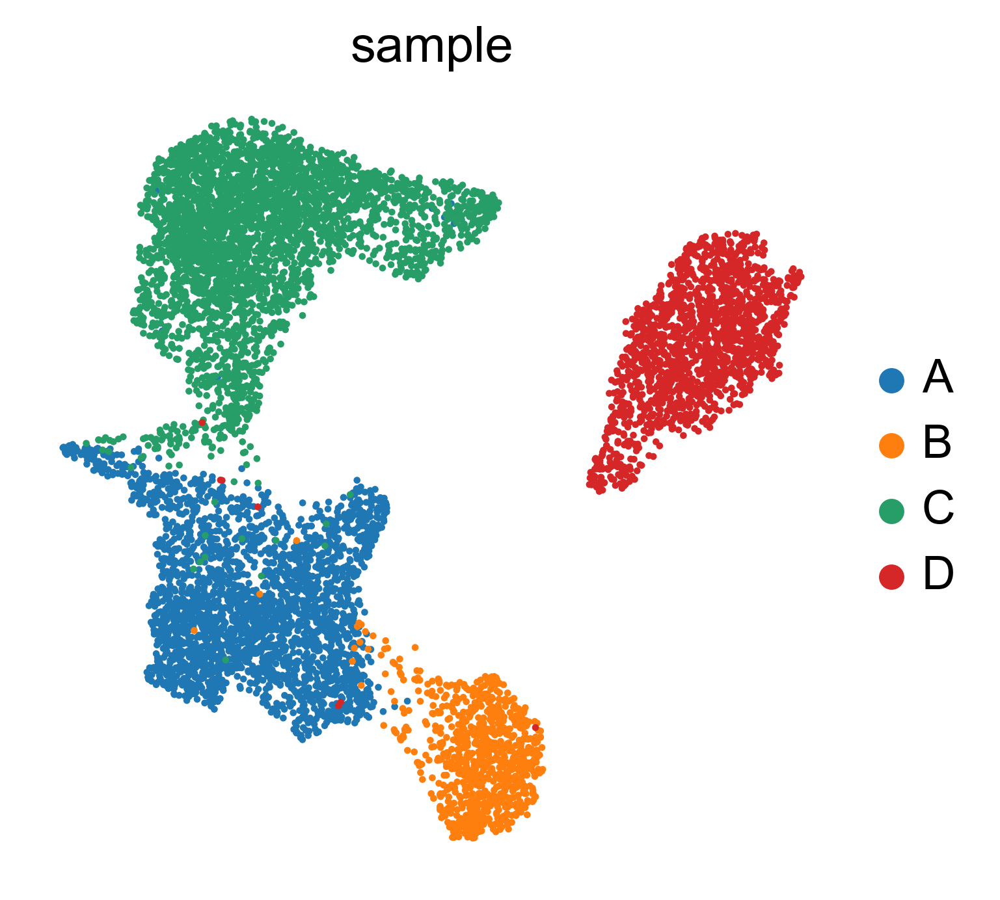

In [61]:
#group by sample
sc.pl.umap(query_latent,
           color=['sample'],
           frameon=False,
           wspace=0.6,
           )


/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


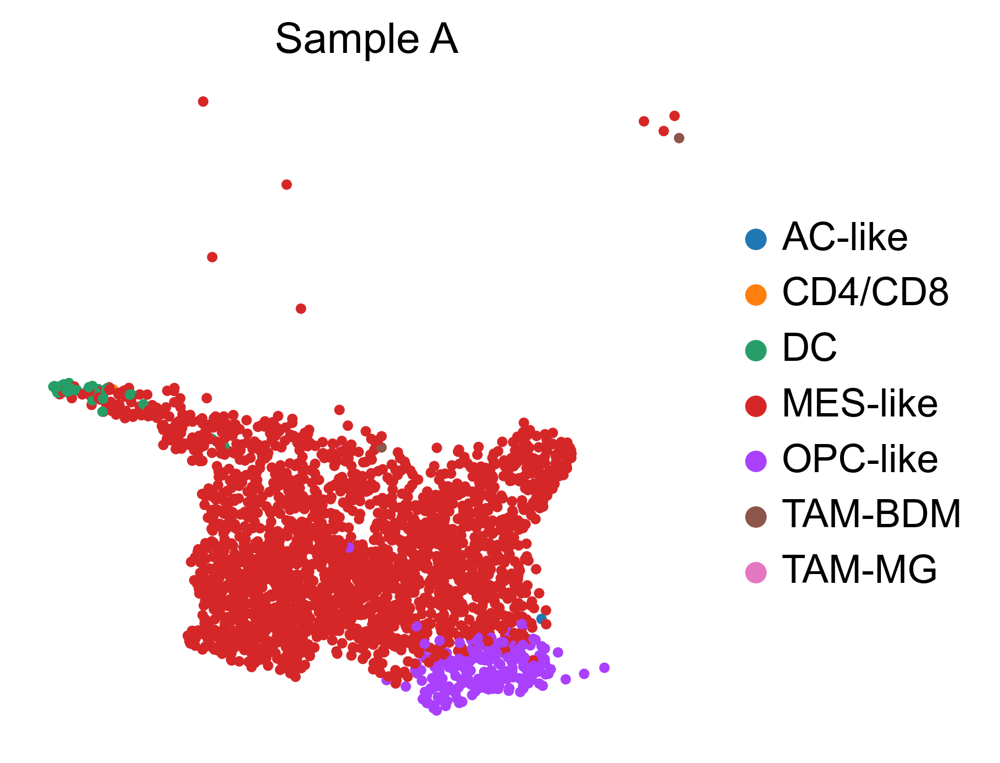

/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


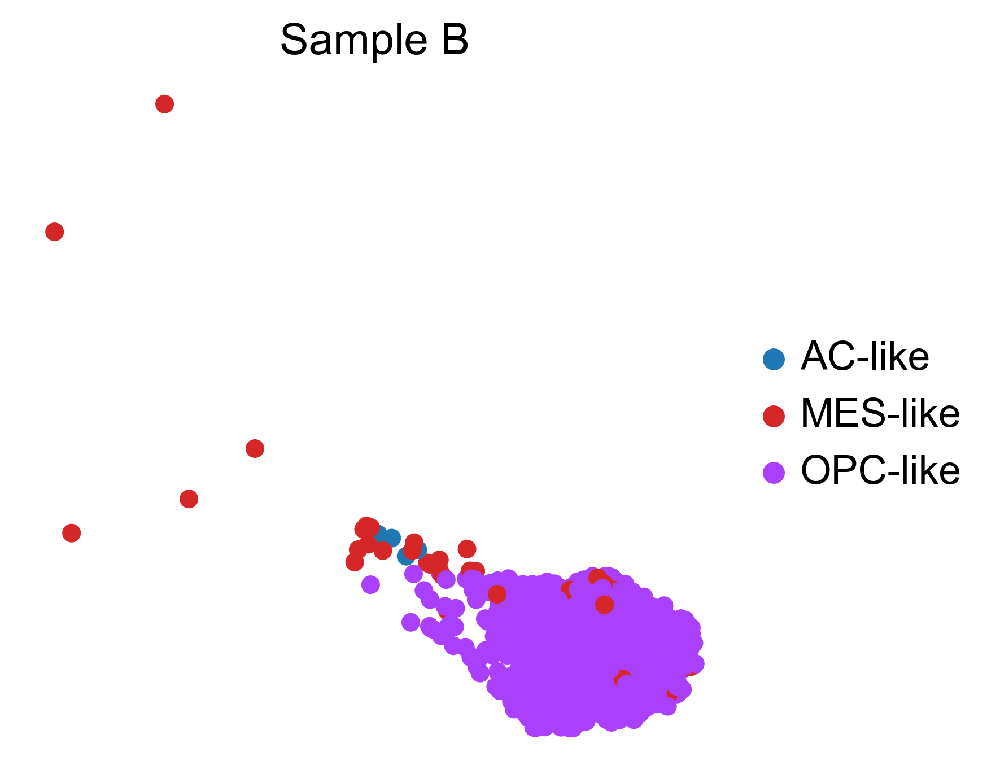

/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


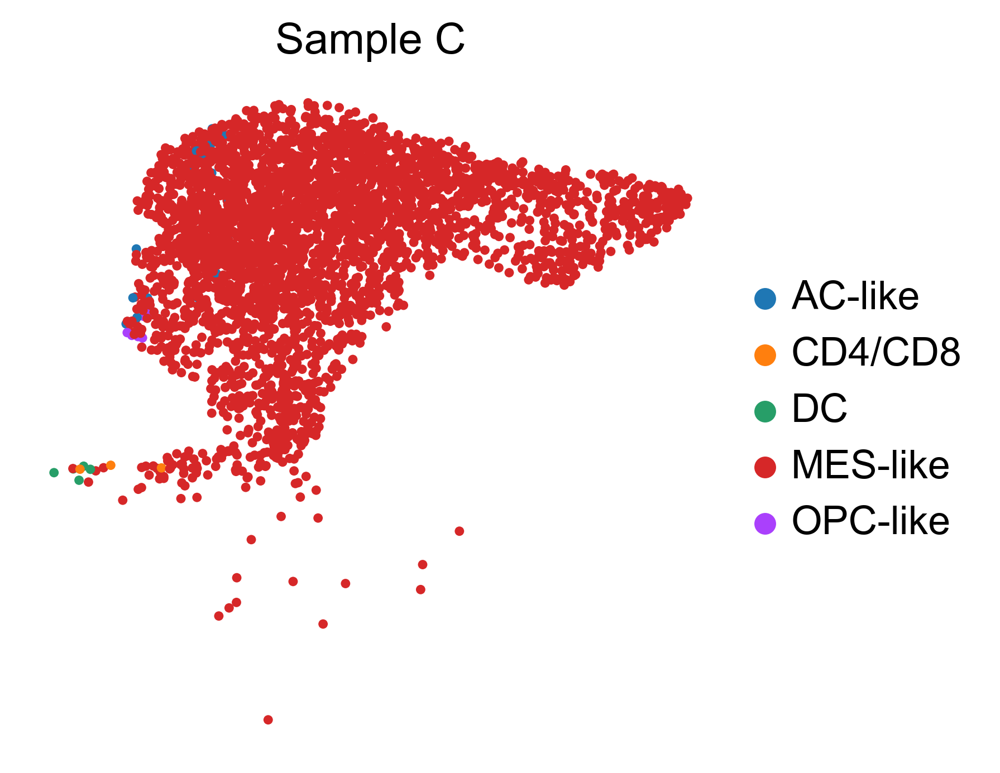

/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


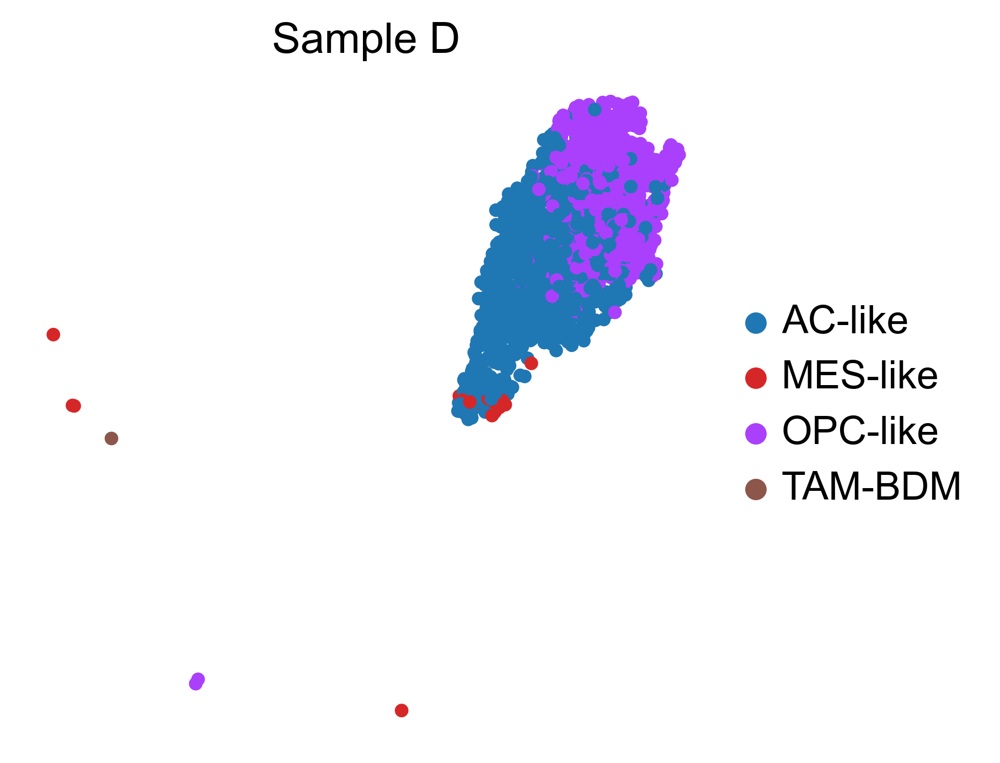

/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


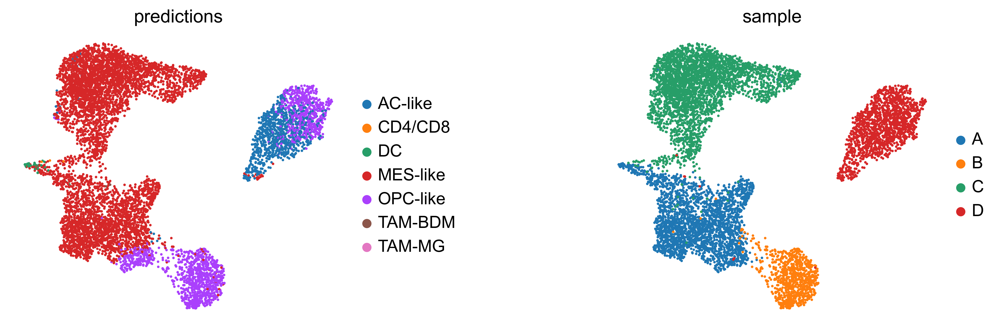

/var/folders/wk/1gf2_m552kl8lnst82lpjrn00000gn/T/ipykernel_64442/1713251626.py:47: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  query_latent.obs.groupby(['sample', 'predictions']).size().unstack(fill_value=0)


predictions,AC-like,CD4/CD8,DC,MES-like,OPC-like,TAM-BDM,TAM-MG
sample,,,,,,,
A,1,1,39,2313,208,2,1
B,4,0,0,38,807,0,0
C,22,3,5,3228,6,0,0
D,887,0,0,21,608,1,0


In [62]:
#show only predictions on sample C
sc.pl.umap(query_latent[query_latent.obs['sample'] == 'A'],
           color=['predictions'],
           frameon=False,
           wspace=0.6,
              title='Sample A'
        
           )

#show only predictions on sample D
sc.pl.umap(query_latent[query_latent.obs['sample'] == 'B'],
           color=['predictions'],
           frameon=False,
           wspace=0.6,
           title='Sample B'
        
           )

#show only predictions on sample C
sc.pl.umap(query_latent[query_latent.obs['sample'] == 'C'],
           color=['predictions'],
           frameon=False,
           wspace=0.6,
           title='Sample C'
        
           )

#show only predictions on sample D
sc.pl.umap(query_latent[query_latent.obs['sample'] == 'D'],
           color=['predictions'],
           frameon=False,
           wspace=0.6,
           title='Sample D'
        
           )

#plot grid by predictions
sc.pl.umap(query_latent,
           color=['predictions', 'sample'],
           frameon=False,
           wspace=0.6,
           ncols=3,
           )


#print counts for each cell type for each sample
query_latent.obs.groupby(['sample', 'predictions']).size().unstack(fill_value=0)


In [63]:
query_latent.obs.groupby(['sample', 'predictions']).size().unstack(fill_value=0)


/var/folders/wk/1gf2_m552kl8lnst82lpjrn00000gn/T/ipykernel_64442/3666619035.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  query_latent.obs.groupby(['sample', 'predictions']).size().unstack(fill_value=0)


predictions,AC-like,CD4/CD8,DC,MES-like,OPC-like,TAM-BDM,TAM-MG
sample,,,,,,,
A,1,1,39,2313,208,2,1
B,4,0,0,38,807,0,0
C,22,3,5,3228,6,0,0
D,887,0,0,21,608,1,0


/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


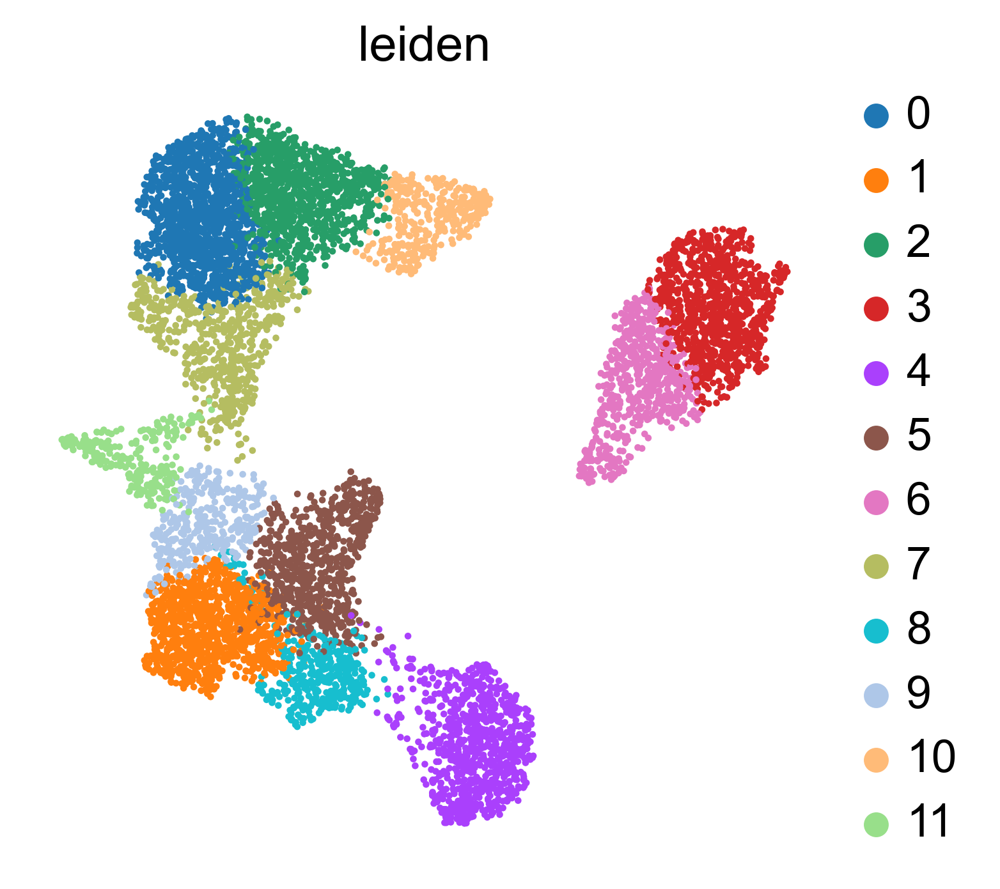

In [64]:
sc.pl.umap(query_latent,
           color=['leiden'],
           frameon=False,
           wspace=0.6,
           )

In [63]:
#save latent representation-latns
query_latent.write("./scarches_SCANVI)latens1.h5ad")



: 

In [55]:
query_latent.obs['predictions']

spot_id
A-AK40374-AK40375_225GY5LT3_AAACAACGAATAGTTC-1    OPC-like
A-AK40374-AK40375_225GY5LT3_AAACACCAATAACTGC-1          DC
A-AK40374-AK40375_225GY5LT3_AAACAGAGCGACTCCT-1    OPC-like
A-AK40374-AK40375_225GY5LT3_AAACAGCTTTCAGAAG-1    MES-like
A-AK40374-AK40375_225GY5LT3_AAACAGGGTCTATATT-1    MES-like
                                                    ...   
A-AK40374-AK40375_225GY5LT3_TTGTTCAGTGTGCTAC-1    MES-like
A-AK40374-AK40375_225GY5LT3_TTGTTCTAGATACGCT-1    MES-like
A-AK40374-AK40375_225GY5LT3_TTGTTGTGTGTCAAGA-1    MES-like
A-AK40374-AK40375_225GY5LT3_TTGTTTCACATCCAGG-1    MES-like
A-AK40374-AK40375_225GY5LT3_TTGTTTCATTAGTCTA-1    MES-like
Name: predictions, Length: 2565, dtype: category
Categories (8, object): ['AC-like', 'CD4/CD8', 'DC', 'MES-like', 'OPC-like', 'Oligodendrocyte', 'TAM-BDM', 'TAM-MG']

In [61]:
query_latent

AnnData object with n_obs × n_vars = 2565 × 10
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'CellID', 'author', '_scvi_batch', '_scvi_labels', 'predictions', 'ref_or_query', 'leiden'
    uns: 'neighbors', 'leiden', 'umap', 'predictions_colors', 'leiden_colors', 'rank_genes_groups'
    obsm: 'X_umap'
    obsp: 'distances', 'connectivities'

In [66]:
adata_full = source_adata.concatenate(adata_query, batch_key="ref_query")
full_latent = sc.AnnData(model.get_latent_representation(adata=adata_full))


/var/folders/wk/1gf2_m552kl8lnst82lpjrn00000gn/T/ipykernel_64442/3523603327.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_full = source_adata.concatenate(adata_query, batch_key="ref_query")
/Users/carbs/miniforge3/envs/ai/lib/python3.11/site-packages/anndata/_core/merge.py:1356: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             
mappinggggg ['Bhaduri2020' 'Couturier2020' 'Darmanis2017' 'Goswami2019' 'Johnson2020'
 'Mathewson2021' 'Neftel2019_10x' 'Neftel2019_smart' 'Pombo2021'
 'Richards2021' 'Sankowski2019' 'Wang2019' 'Wang2020' 'Wu2020' 'Yu2020'
 'Yuan2018' 'Zhao2020' 'A' 'B' 'C' 'D']
mappinggggg extend_categories False
searching for A
searching for B
searching for Bhaduri2020
searching for C
searching for Couturier2020
searching for D
searching for Darmanis2017
searching for Goswami2019
searching for Johnson2020
searching for Mathewson2021
searching for Neftel2019_10x
searching for Neftel2019_smart
searching for Pombo2021
searching for Richards2021
searching for Sankowski2019
searching for Wang2019
searching for Wang2020
searching for Wu2020
searching for Yu2020
searching for Yuan2018
searching for Zhao2020
mappinggggg ['AC-like' 'Astrocyte' 'B cell' 'CD4/CD8' 'DC' 'Endothelial' 'MES-like'
 'M

In [67]:
#set metadata
full_latent.obs = adata_full.obs.loc[adata_full.obs.index, :]

In [68]:
full_latent

AnnData object with n_obs × n_vars = 346759 × 10
    obs: 'author', 'patient', 'method', 'CellID', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'ref_or_query', 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'ref_query'

In [69]:
sc.pp.neighbors(full_latent)
sc.tl.leiden(full_latent)
sc.tl.umap(full_latent)



In [70]:
#addd predictions

full_latent.obs['predictions_with_full'] = model.predict(adata=adata_full)





/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


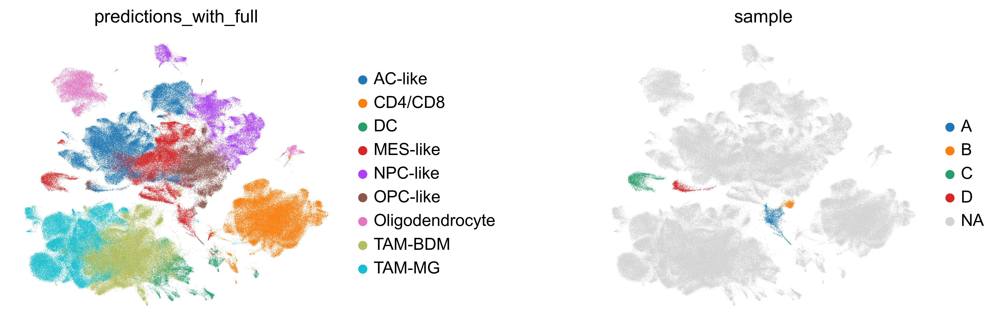

In [82]:
sc.pl.umap(full_latent,
           frameon=False,
           wspace=0.6,
              color=['predictions_with_full', 'sample'], 
           )

In [74]:
 #gett acuuarcy on predicting the source dont use  ref_query 1
predss = full_latent.obs[ full_latent.obs['ref_query'] == '0' ]['predictions_with_full']
og = full_latent.obs[ full_latent.obs['ref_query'] == '0' ]['CellID']
og

#accuracy
from sklearn.metrics import accuracy_score
accuracy_score(og, predss)


0.8891081154523222

/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_utils.py:464: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


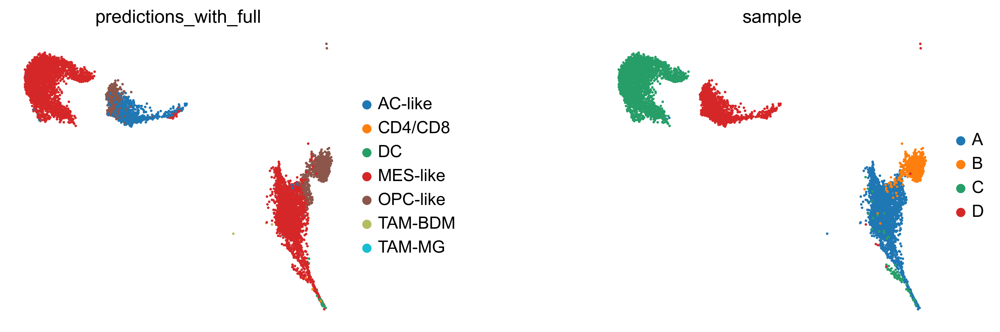

In [76]:
#show predictions of only C and D together and mark them with different colors
sc.pl.umap(full_latent[full_latent.obs['ref_query'] == '1'],
           frameon=False,
           wspace=0.6,
              color=['predictions_with_full', 'sample'],

         
            
           )





/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


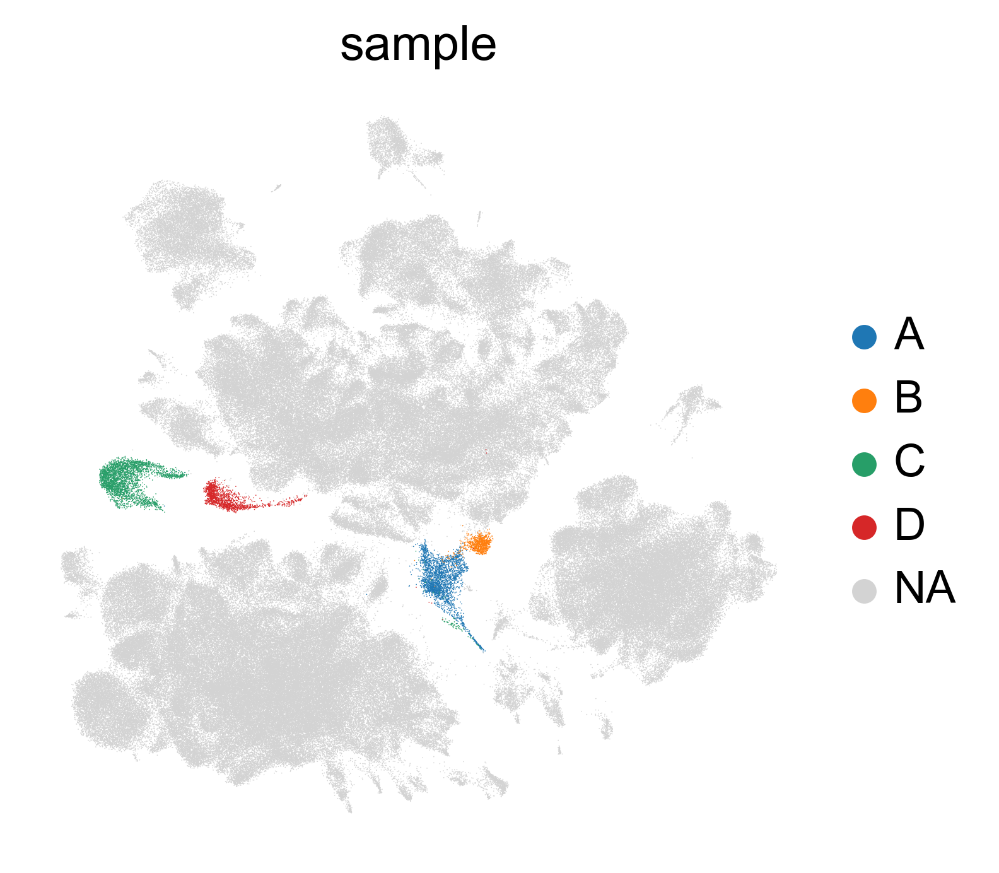

In [77]:
sc.pl.umap(full_latent,
           frameon=False,
           wspace=0.6,
              color=['sample'],   
           )


#predict




In [80]:
#get ptedictions
# query_latent.obs.groupby(['sample', 'predictions']).size().unstack(fill_value=0)
full_latent.obs.groupby(['sample', 'predictions_with_full']).size().unstack(fill_value=0)


/var/folders/wk/1gf2_m552kl8lnst82lpjrn00000gn/T/ipykernel_64442/3769369338.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  full_latent.obs.groupby(['sample', 'predictions_with_full']).size().unstack(fill_value=0)


predictions_with_full,AC-like,CD4/CD8,DC,MES-like,NPC-like,OPC-like,Oligodendrocyte,TAM-BDM,TAM-MG
sample,,,,,,,,,
A,1,1,39,2313,0,208,0,2,1
B,4,0,0,38,0,807,0,0,0
C,22,3,5,3228,0,6,0,0,0
D,887,0,0,21,0,608,0,1,0


/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


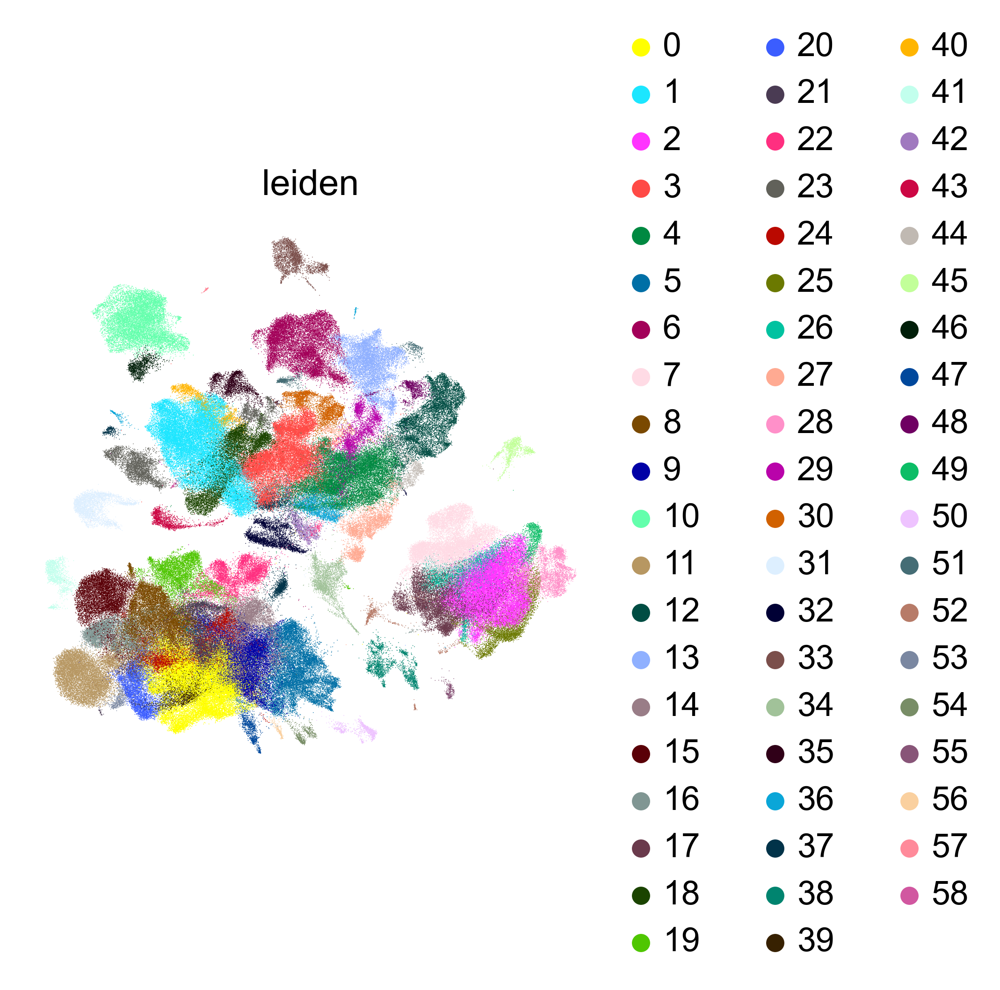

In [78]:
#laiedn

sc.pl.umap(full_latent,
              frameon=False,
              wspace=0.6,
                  color=['leiden'],   
              )


/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


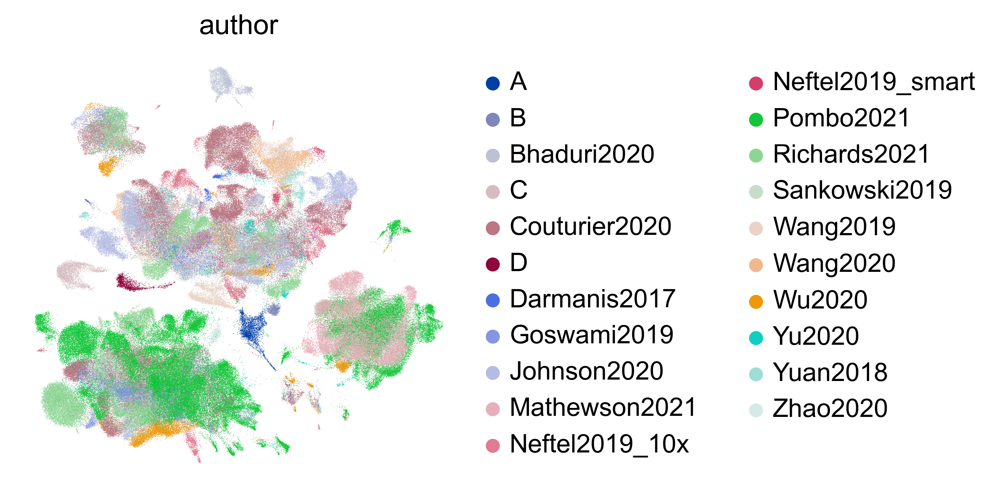

In [79]:
#author
sc.pl.umap(full_latent,
              frameon=False,
              wspace=0.6,
                  color=['author'],   
              )

In [98]:
full_latent.obs

,author,patient,method,CellID,_scvi_batch,_scvi_labels,_scvi_local_l_mean,_scvi_local_l_var,ref_or_query,in_tissue,...,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,ref_query,predictions,leiden
PJ017_0-0,Yuan2018,PJ017,cell,MES-like,15,6,6.441088,0.417351,ref,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,MES-like,5
PJ017_1-0,Yuan2018,PJ017,cell,OPC-like,15,14,6.441088,0.417351,ref,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,MES-like,3
PJ017_2-0,Yuan2018,PJ017,cell,TAM-BDM,15,18,6.441088,0.417351,ref,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,TAM-BDM,0
PJ017_3-0,Yuan2018,PJ017,cell,MES-like,15,6,6.441088,0.417351,ref,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,MES-like,5
PJ017_4-0,Yuan2018,PJ017,cell,AC-like,15,0,6.441088,0.417351,ref,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,AC-like,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D-AK40380-AK40381_225GY5LT3_TTGTTAGCAAATTCGA-1-1,Luka_batch_1,NaN,NaN,MES-like,17,6,NaN,NaN,NaN,1.0,...,8.521584,11946.0,9.388235,13.661477,18.801272,25.749205,38.858195,1,OPC-like,41
D-AK40380-AK40381_225GY5LT3_TTGTTCTAGATACGCT-1-1,Luka_batch_1,NaN,NaN,MES-like,17,6,NaN,NaN,NaN,1.0,...,8.472405,10746.0,9.282382,12.953657,18.416155,25.414108,38.619021,1,OPC-like,41
D-AK40380-AK40381_225GY5LT3_TTGTTGTGTGTCAAGA-1-1,Luka_batch_1,NaN,NaN,MES-like,17,6,NaN,NaN,NaN,1.0,...,8.634976,14777.0,9.600895,13.121743,18.149827,25.045679,38.106517,1,OPC-like,41
D-AK40380-AK40381_225GY5LT3_TTGTTTCCATACAACT-1-1,Luka_batch_1,NaN,NaN,MES-like,17,6,NaN,NaN,NaN,1.0,...,8.427268,9944.0,9.204825,13.093323,18.604183,25.653660,39.390587,1,OPC-like,41


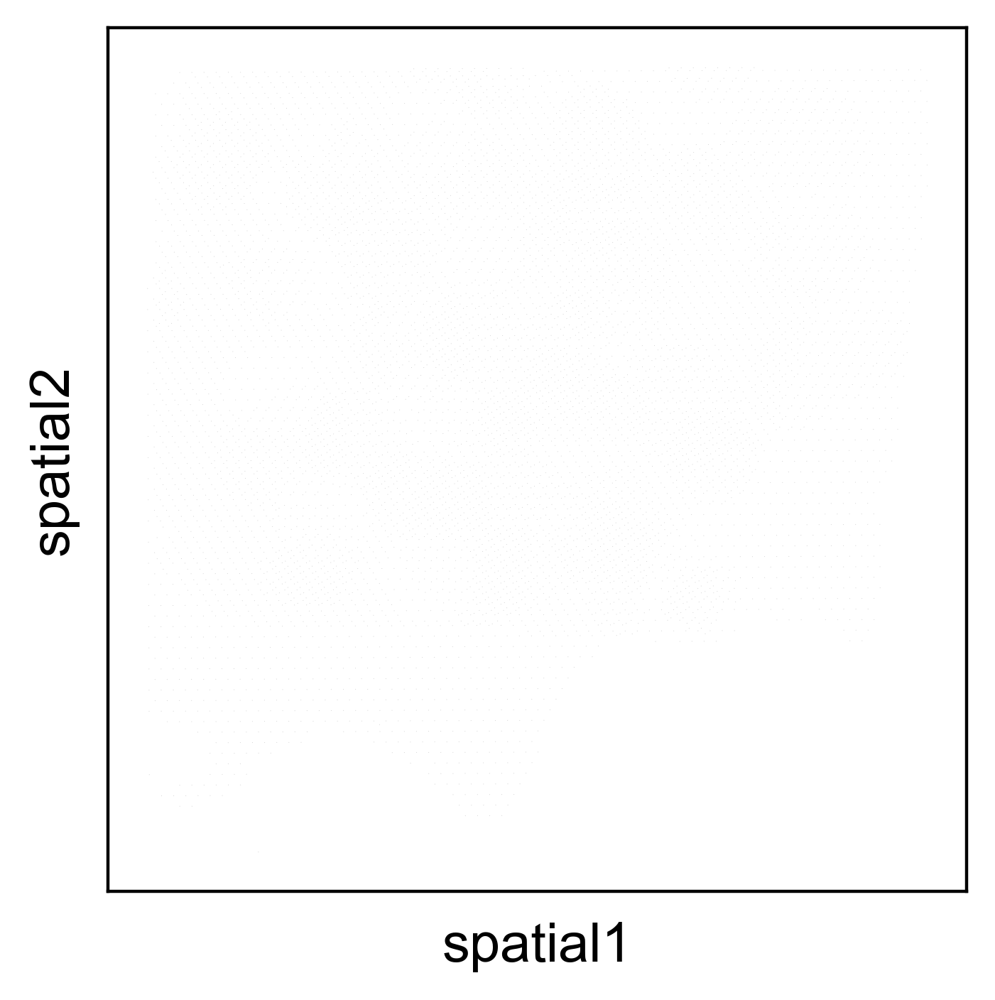

In [91]:
#plot visium data
sc.pl.spatial(target_adata, spot_size=10)


# #make a copy and add predictions to the right index
# target_adata_A_copy = target_adata_A.copy()
# target_adata_A_copy.obs = full_latent.obs.loc[target_adata_A.obs.index, :]
# target_adata_A_copy.obs['predictions'] = full_latent.obs['predictions_with_full'].loc[target_adata_A.obs.index]

# #plot visium data with predictions
# sc.pl.spatial(target_adata_A_copy, color='predictions', spot_size=10)

In [111]:
#add uns images to the adata target_adata_A, target_adata_B, target_adata_C, target_adata_D

A_sample = full_latent[full_latent.obs['sample'] == 'A'].copy()

#remove the added -A-1 at the end of index names
A_sample.obs.index = A_sample.obs.index.str[:-4]

preds = A_sample.obs['predictions_with_full']

target_adata_A_with_preds = target_adata_A.copy()

target_adata_A_with_preds.obs = A_sample.obs.loc[target_adata_A.obs.index, :]


In [219]:
B_sample = full_latent[full_latent.obs['sample'] == 'B'].copy()
B_sample.obs.index = B_sample.obs.index.str[:-4]
target_adata_B_with_preds = target_adata_B.copy()
target_adata_B_with_preds.obs = B_sample.obs.loc[target_adata_B.obs.index, :]
target_adata_B_with_preds.obs['predictions'] = B_sample.obs['predictions_with_full'].loc[target_adata_B.obs.index]

C_sample = full_latent[full_latent.obs['sample'] == 'C'].copy()
C_sample.obs.index = C_sample.obs.index.str[:-4]
target_adata_C_with_preds = target_adata_C.copy()
target_adata_C_with_preds.obs = C_sample.obs.loc[target_adata_C.obs.index, :]
target_adata_C_with_preds.obs['predictions'] = C_sample.obs['predictions_with_full'].loc[target_adata_C.obs.index]

D_sample = full_latent[full_latent.obs['sample'] == 'D'].copy()
D_sample.obs.index = D_sample.obs.index.str[:-4]
target_adata_D_with_preds = target_adata_D.copy()
target_adata_D_with_preds.obs = D_sample.obs.loc[target_adata_D.obs.index, :]
target_adata_D_with_preds.obs['predictions'] = D_sample.obs['predictions_with_full'].loc[target_adata_D.obs.index]


In [113]:
target_adata_A_with_preds.obs

,author,patient,method,CellID,_scvi_batch,_scvi_labels,_scvi_local_l_mean,_scvi_local_l_var,ref_or_query,in_tissue,...,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,ref_query,leiden,predictions_with_full
spot_id,,,,,,,,,,,,,,,,,,,,,
A-AK40374-AK40375_225GY5LT3_AAACAACGAATAGTTC-1,A,NaN,NaN,MES-like,17,6,NaN,NaN,NaN,1.0,...,8.093768,5353.0,8.585599,10.293293,15.281151,22.940407,38.501775,1,34,MES-like
A-AK40374-AK40375_225GY5LT3_AAACACCAATAACTGC-1,A,NaN,NaN,MES-like,17,6,NaN,NaN,NaN,1.0,...,8.093768,6295.0,8.747670,18.649722,24.241461,31.818904,46.783161,1,34,DC
A-AK40374-AK40375_225GY5LT3_AAACAGAGCGACTCCT-1,A,NaN,NaN,MES-like,17,6,NaN,NaN,NaN,1.0,...,8.318986,7777.0,8.959055,12.254083,17.281728,24.431015,38.485277,1,34,MES-like
A-AK40374-AK40375_225GY5LT3_AAACAGCTTTCAGAAG-1,A,NaN,NaN,MES-like,17,6,NaN,NaN,NaN,1.0,...,7.538495,2502.0,7.825245,11.670663,17.825739,26.298961,44.924061,1,34,MES-like
A-AK40374-AK40375_225GY5LT3_AAACAGGGTCTATATT-1,A,NaN,NaN,MES-like,17,6,NaN,NaN,NaN,1.0,...,7.188413,1664.0,7.417581,13.161058,19.711538,31.730769,50.540865,1,34,MES-like
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
A-AK40374-AK40375_225GY5LT3_TTGTTCAGTGTGCTAC-1,A,NaN,NaN,MES-like,17,6,NaN,NaN,NaN,1.0,...,7.805475,3777.0,8.236950,13.635160,19.380461,27.826317,44.479746,1,34,MES-like
A-AK40374-AK40375_225GY5LT3_TTGTTCTAGATACGCT-1,A,NaN,NaN,MES-like,17,6,NaN,NaN,NaN,1.0,...,7.030857,1443.0,7.275172,14.483714,21.829522,35.550936,56.340956,1,34,MES-like
A-AK40374-AK40375_225GY5LT3_TTGTTGTGTGTCAAGA-1,A,NaN,NaN,MES-like,17,6,NaN,NaN,NaN,1.0,...,7.109062,1525.0,7.330405,14.819672,21.377049,32.983607,52.655738,1,34,MES-like


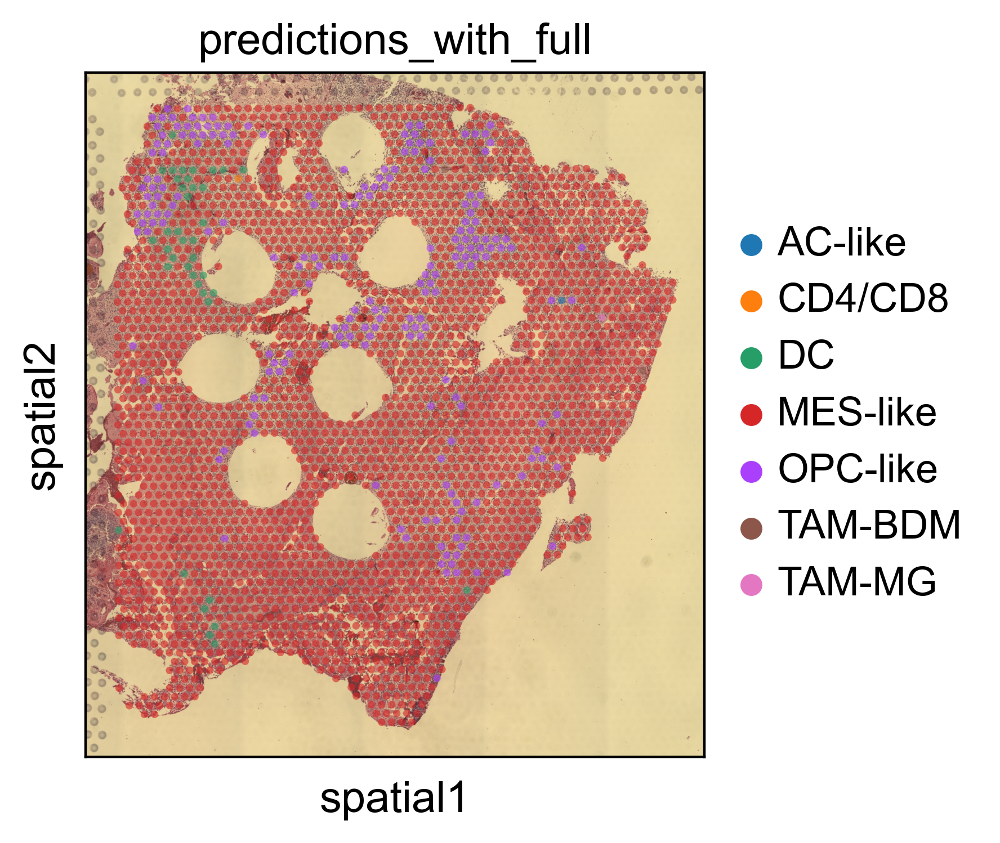

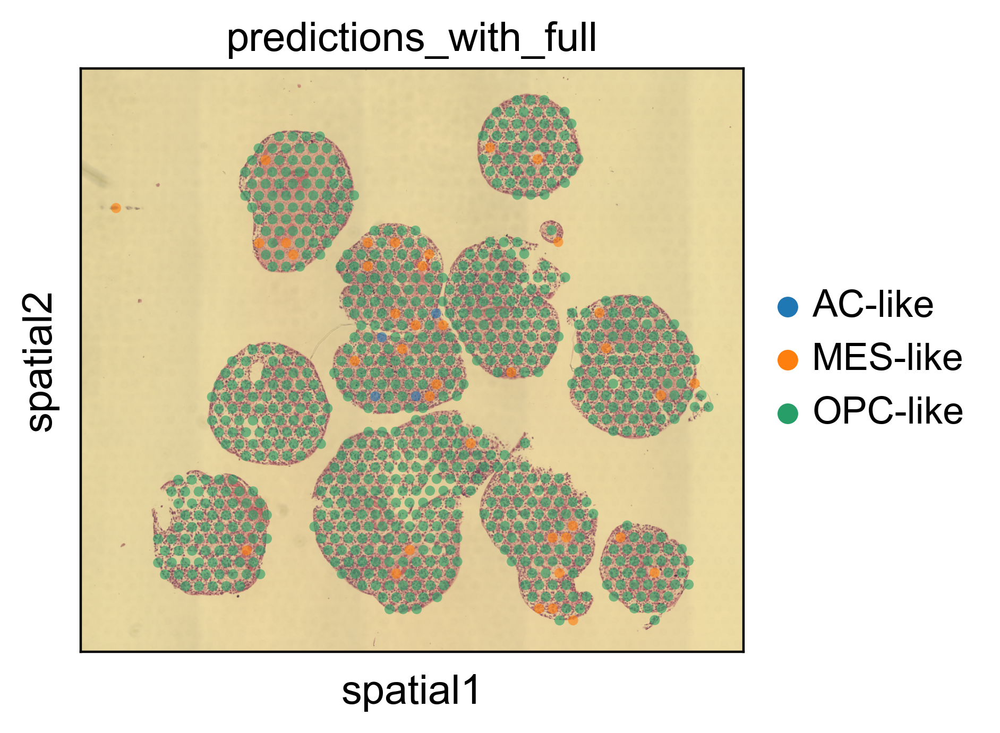

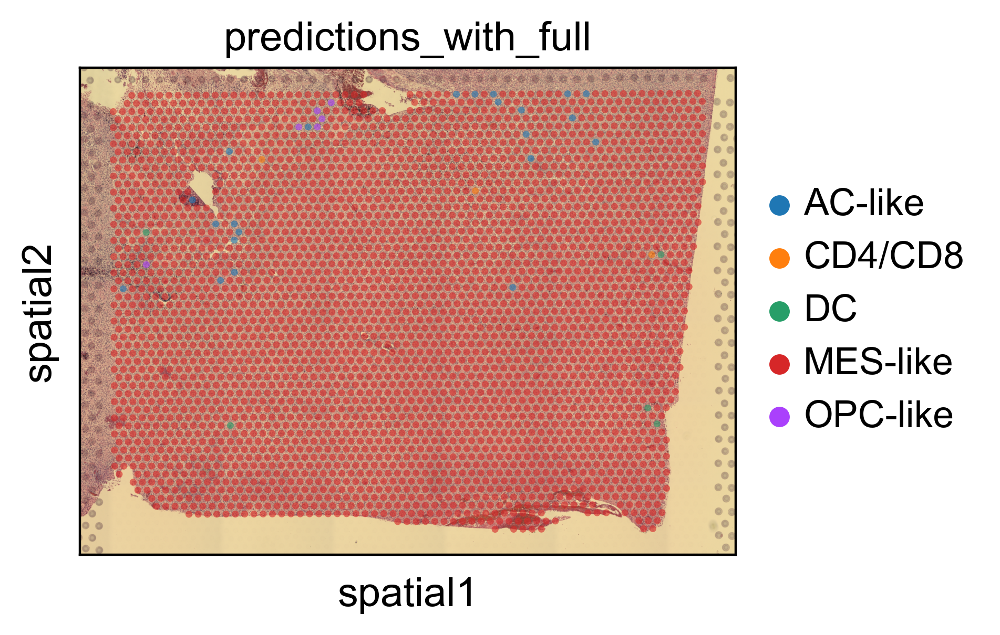

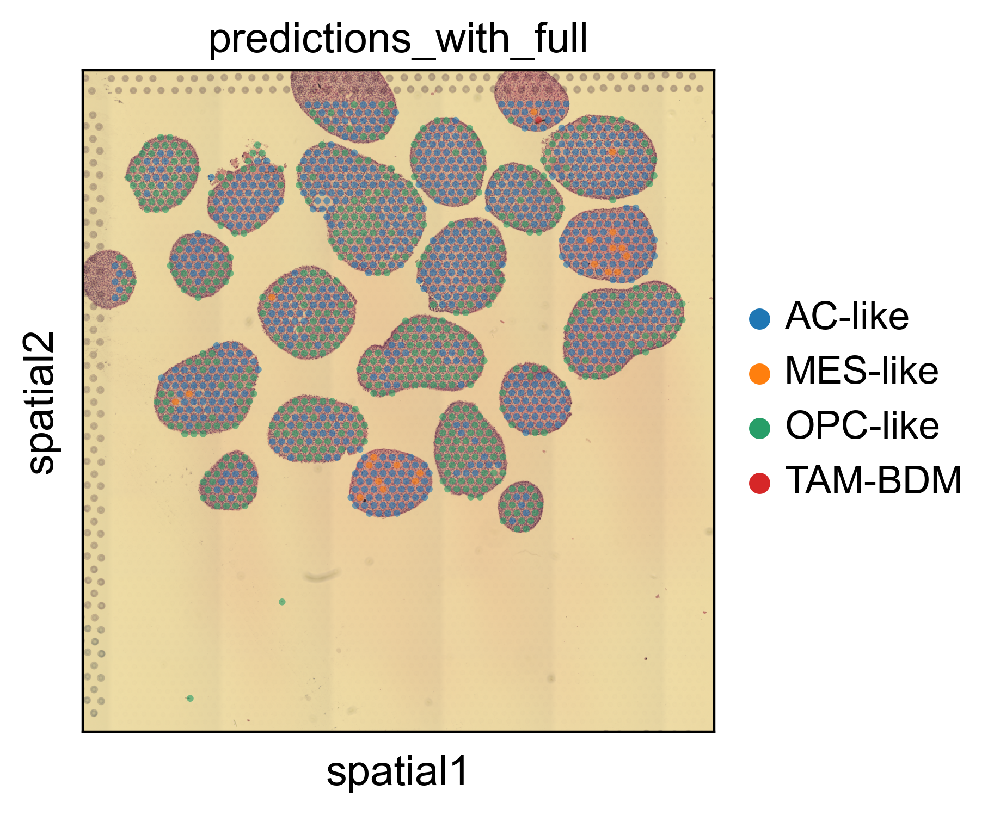

In [220]:
#plot visium data with predictions
sc.pl.spatial(target_adata_A_with_preds, color='predictions_with_full', spot_size=120, img_key='hires', cmap='viridis',alpha=0.6)
sc.pl.spatial(target_adata_B_with_preds, color='predictions_with_full', spot_size=120, img_key='hires', cmap='viridis',alpha=0.6)
sc.pl.spatial(target_adata_C_with_preds, color='predictions_with_full', spot_size=120, img_key='hires', cmap='viridis',alpha=0.6)
sc.pl.spatial(target_adata_D_with_preds, color='predictions_with_full', spot_size=120, img_key='hires', cmap='viridis',alpha=0.6)


In [134]:
full_latent.obs.groupby(['sample', 'predictions_with_full']).size().unstack(fill_value=0)


/var/folders/wk/1gf2_m552kl8lnst82lpjrn00000gn/T/ipykernel_64442/3432826606.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  full_latent.obs.groupby(['sample', 'predictions_with_full']).size().unstack(fill_value=0)


predictions_with_full,AC-like,CD4/CD8,DC,MES-like,NPC-like,OPC-like,Oligodendrocyte,TAM-BDM,TAM-MG
sample,,,,,,,,,
A,1,1,39,2313,0,208,0,2,1
B,4,0,0,38,0,807,0,0,0
C,22,3,5,3228,0,6,0,0,0
D,887,0,0,21,0,608,0,1,0


In [136]:
#perform manula annotation using marker genes

#load marker genes
marker_genes_level3 = pd.read_csv("/Users/carbs/Downloads/Spatial_Meta/Level-4 annotation.csv")
marker_genes_level3.head()

,List,Name,ID,Feature Type
0,AC-like,GFAP,ENSG00000131095,Gene Expression
1,AC-like,FABP7,ENSG00000164434,Gene Expression
2,AC-like,MT3,ENSG00000087250,Gene Expression
3,AC-like,EGFR,ENSG00000146648,Gene Expression
4,AC-like,PTN,ENSG00000105894,Gene Expression


In [151]:
target_adata_A_with_preds.var_names

Index(['SAMD11', 'NOC2L', 'KLHL17', 'PLEKHN1', 'PERM1', 'HES4', 'ISG15',
       'AGRN', 'RNF223', 'C1orf159',
       ...
       'SRY', 'ZFY', 'PCDH11Y', 'AMELY', 'TBL1Y', 'TSPY1', 'USP9Y', 'DDX3Y',
       'TMSB4Y', 'KDM5D'],
      dtype='object', length=17943)

In [153]:
#compute umap of  target_adata_A_with_preds
sc.pp.neighbors(target_adata_A_with_preds)
sc.tl.umap(target_adata_A_with_preds)


         Falling back to preprocessing with `sc.pp.pca` and default params.


In [204]:
# open xlsx file media-1.xlsx
markersss = pd.read_excel("media-1.xlsx", sheet_name="S4", header=[0, 1])
print(markersss.columns)


# MultiIndex([('Level-1 annotation',      'p_val'),
#             ('Level-1 annotation', 'avg_log2FC'),
#             ('Level-1 annotation',      'pct.1'),
#             ('Level-1 annotation',      'pct.2'),

# #get level-1 annotation
# load renaming from csv


# for level_type in [
#     "Level-1 annotation",
#     "Level-2 annotation",
#     "Level-3 annotation",
#     "Level-4 annotation",
# ]:
marker_genes_level3 = markersss['Level-3 annotation']
#drop na
marker_genes_level3 = marker_genes_level3.dropna()
marker_genes_level3

#group by cluster
gene_sets = marker_genes_level3.groupby("cluster").apply(lambda x: x["gene"].tolist())


MultiIndex([('Level-1 annotation',      'p_val'),
            ('Level-1 annotation', 'avg_log2FC'),
            ('Level-1 annotation',      'pct.1'),
            ('Level-1 annotation',      'pct.2'),
            ('Level-1 annotation',  'p_val_adj'),
            ('Level-1 annotation',    'cluster'),
            ('Level-1 annotation',       'gene'),
            ('Level-2 annotation',      'p_val'),
            ('Level-2 annotation', 'avg_log2FC'),
            ('Level-2 annotation',      'pct.1'),
            ('Level-2 annotation',      'pct.2'),
            ('Level-2 annotation',  'p_val_adj'),
            ('Level-2 annotation',    'cluster'),
            ('Level-2 annotation',       'gene'),
            ('Level-3 annotation',      'p_val'),
            ('Level-3 annotation', 'avg_log2FC'),
            ('Level-3 annotation',      'pct.1'),
            ('Level-3 annotation',      'pct.2'),
            ('Level-3 annotation',  'p_val_adj'),
            ('Level-3 annotation',    'cluster'),


/var/folders/wk/1gf2_m552kl8lnst82lpjrn00000gn/T/ipykernel_64442/3032181511.py:27: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  gene_sets = marker_genes_level3.groupby("cluster").apply(lambda x: x["gene"].tolist())


In [207]:

#read tsv file
signatures = pd.read_csv("/Users/carbs/Downloads/Spatial_Meta/IDHwt.GBM.MetaModules (1).tsv", sep="\t")

0        CST3
1       S100B
2      SLC1A3
3       HEPN1
4        HOPX
5         MT3
6     SPARCL1
7        MLC1
8        GFAP
9       FABP7
10       BCAN
11       PON2
12    METTL7B
13      SPARC
14       GATM
15      RAMP1
16       PMP2
17       AQP4
18        DBI
19      EDNRB
20     PTPRZ1
21        CLU
22      PMP22
23     ATP1A2
24    S100A16
25       HEY1
26    PCDHGC3
27      TTYH1
28      NDRG2
29       PRCP
30     ATP1B2
31        AGT
32       PLTP
33      GPM6B
34         F3
35      RAB31
36     PPAP2B
37      ANXA5
38     TSPAN7
39        NaN
40        NaN
41        NaN
42        NaN
43        NaN
44        NaN
45        NaN
46        NaN
47        NaN
48        NaN
49        NaN
Name: AClike, dtype: object

In [222]:
normalized_target_adata_A = target_adata_A_with_preds.copy()
sc.pp.normalize_total(normalized_target_adata_A, target_sum=1e4)

normalized_target_adata_B = target_adata_B_with_preds.copy()
sc.pp.normalize_total(normalized_target_adata_B, target_sum=1e4)

normalized_target_adata_C = target_adata_C_with_preds.copy()
sc.pp.normalize_total(normalized_target_adata_C, target_sum=1e4)

normalized_target_adata_D = target_adata_D_with_preds.copy()
sc.pp.normalize_total(normalized_target_adata_D, target_sum=1e4)

#compute umap
sc.pp.neighbors(normalized_target_adata_A)
sc.tl.umap(normalized_target_adata_A)

sc.pp.neighbors(normalized_target_adata_B)
sc.tl.umap(normalized_target_adata_B)

sc.pp.neighbors(normalized_target_adata_C)
sc.tl.umap(normalized_target_adata_C)

sc.pp.neighbors(normalized_target_adata_D)
sc.tl.umap(normalized_target_adata_D)



/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/preprocessing/_normalization.py:211: UserWarning: Some cells have zero counts
  warn(UserWarning("Some cells have zero counts"))


         Falling back to preprocessing with `sc.pp.pca` and default params.
         Falling back to preprocessing with `sc.pp.pca` and default params.
         Falling back to preprocessing with `sc.pp.pca` and default params.


In [223]:
for sig in signatures.columns:
    print(sig)
    l = signatures[sig].dropna().tolist()
    print(l)
    sc.tl.score_genes(normalized_target_adata_A, gene_list=l, score_name=sig+"_score_signatures")
    sc.tl.score_genes(normalized_target_adata_B, gene_list=l, score_name=sig+"_score_signatures")
    sc.tl.score_genes(normalized_target_adata_C, gene_list=l, score_name=sig+"_score_signatures")
    sc.tl.score_genes(normalized_target_adata_D, gene_list=l, score_name=sig+"_score_signatures")
    


MESlike2
['HILPDA', 'ADM', 'DDIT3', 'NDRG1', 'HERPUD1', 'DNAJB9', 'TRIB3', 'ENO2', 'AKAP12', 'SQSTM1', 'MT1X', 'ATF3', 'NAMPT', 'NRN1', 'SLC2A1', 'BNIP3', 'LGALS3', 'INSIG2', 'IGFBP3', 'PPP1R15A', 'VIM', 'PLOD2', 'GBE1', 'SLC2A3', 'FTL', 'WARS', 'ERO1L', 'XPOT', 'HSPA5', 'GDF15', 'ANXA2', 'EPAS1', 'LDHA', 'P4HA1', 'SERTAD1', 'PFKP', 'PGK1', 'EGLN3', 'SLC6A6', 'CA9', 'BNIP3L', 'RPL21', 'TRAM1', 'UFM1', 'ASNS', 'GOLT1B', 'ANGPTL4', 'SLC39A14', 'CDKN1A', 'HSPA9']
MESlike1
['CHI3L1', 'ANXA2', 'ANXA1', 'CD44', 'VIM', 'MT2A', 'C1S', 'NAMPT', 'EFEMP1', 'C1R', 'SOD2', 'IFITM3', 'TIMP1', 'SPP1', 'A2M', 'S100A11', 'MT1X', 'S100A10', 'FN1', 'LGALS1', 'S100A16', 'CLIC1', 'MGST1', 'RCAN1', 'TAGLN2', 'NPC2', 'SERPING1', 'C8orf4', 'EMP1', 'APOE', 'CTSB', 'C3', 'LGALS3', 'MT1E', 'EMP3', 'SERPINA3', 'ACTN1', 'PRDX6', 'IGFBP7', 'SERPINE1', 'PLP2', 'MGP', 'CLIC4', 'GFPT2', 'GSN', 'NNMT', 'TUBA1C', 'GJA1', 'TNFRSF1A', 'WWTR1']
AClike
['CST3', 'S100B', 'SLC1A3', 'HEPN1', 'HOPX', 'MT3', 'SPARCL1', 'MLC1', '

In [ ]:
for sig in signatures.columns:
    sc.pl.spatial(normalized_target_adata_A, color=[sig+"_score_signatures",'predictions_with_full' ], spot_size=120, img_key='hires', cmap='viridis',alpha=0.6)
    sc.pl.spatial(normalized_target_adata_B, color=[sig+"_score_signatures",'predictions_with_full' ], spot_size=120, img_key='hires', cmap='viridis',alpha=0.6)
    sc.pl.spatial(normalized_target_adata_C, color=[sig+"_score_signatures",'predictions_with_full' ], spot_size=120, img_key='hires', cmap='viridis',alpha=0.6)
    sc.pl.spatial(normalized_target_adata_D, color=[sig+"_score_signatures",'predictions_with_full' ], spot_size=120, img_key='hires', cmap='viridis',alpha=0.6)
    


In [193]:
gene_sets

cluster
Neoplastic        [SEC61G, CLU, PTN, IGFBP2, MT3, PTPRZ1, FABP7,...
Non-neoplastic    [CD74, SPP1, HLA-DRA, CCL3, CCL4, C1QB, HLA-DR...
dtype: object

In [198]:

for cell_type, genes in gene_sets.items():
    sc.tl.score_genes(target_adata_A_with_preds, gene_list=genes, score_name=f'{cell_type}_score', use_raw=False)
    


/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/preprocessing/_normalization.py:211: UserWarning: Some cells have zero counts
  warn(UserWarning("Some cells have zero counts"))


/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/get/get.py:75: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_dotplot.py:811: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


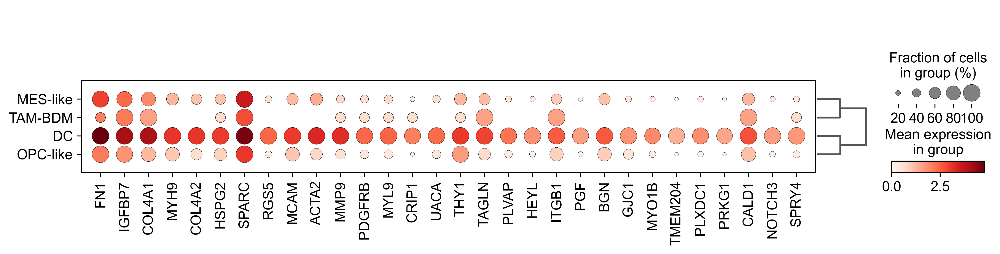

In [203]:

target_adata_A_with_preds_normalized = target_adata_A_with_preds.copy()
sc.pp.normalize_total(target_adata_A_with_preds_normalized, target_sum=1e4)

# Logarithmize the data
sc.pp.log1p(target_adata_A_with_preds_normalized)

# Filter out groups with less than 2 cells
group_counts = target_adata_A_with_preds_normalized.obs['predictions_with_full'].value_counts()
valid_groups = group_counts[group_counts > 1].index.tolist()

# Filter your AnnData object to keep only cells from valid groups
target_adata_filtered = target_adata_A_with_preds_normalized[target_adata_A_with_preds_normalized.obs['predictions_with_full'].isin(valid_groups)].copy()

# Then run rank_genes_groups
sc.tl.rank_genes_groups(target_adata_filtered, groupby='predictions_with_full', method='wilcoxon', n_genes=30)

result = sc.get.rank_genes_groups_df(target_adata_filtered, group=None, key='rank_genes_groups')
top_genes = result['names'].head(30).tolist()  # Adjust the number of top genes as needed
sc.pl.dotplot(target_adata_filtered, var_names=top_genes, groupby='predictions_with_full', dendrogram=True)


/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


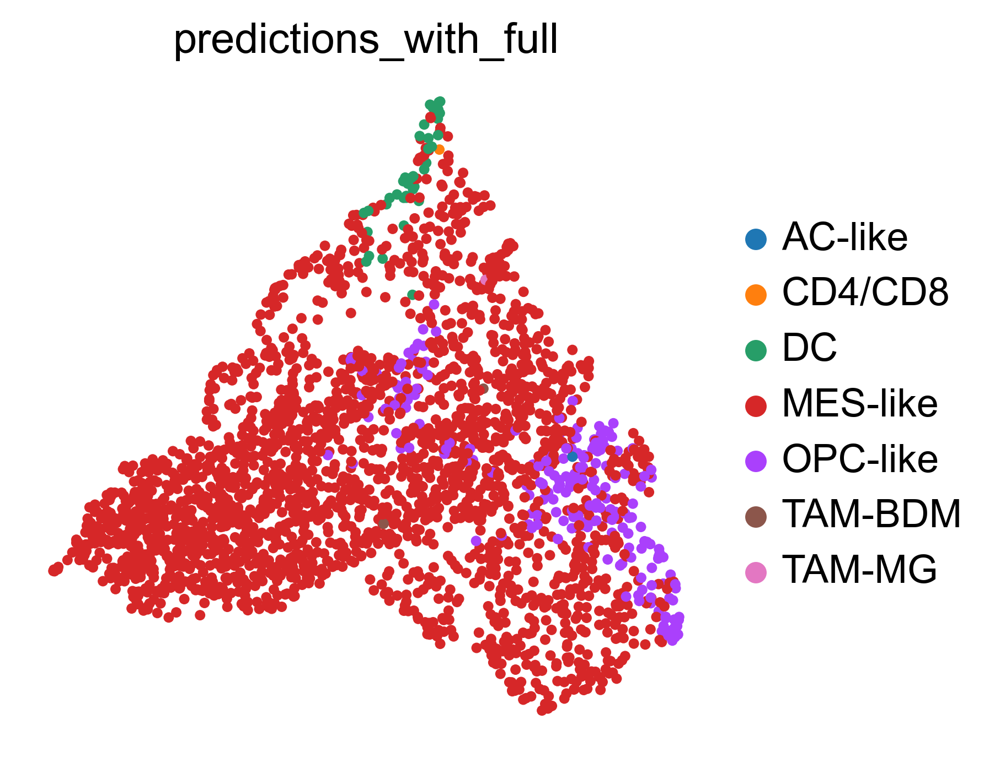

/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


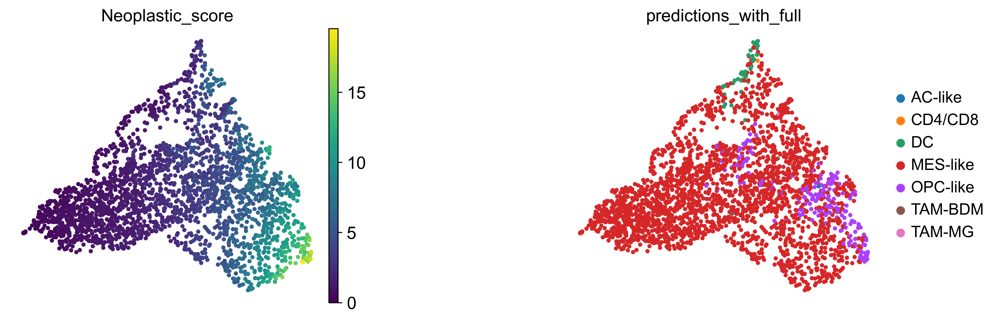

/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


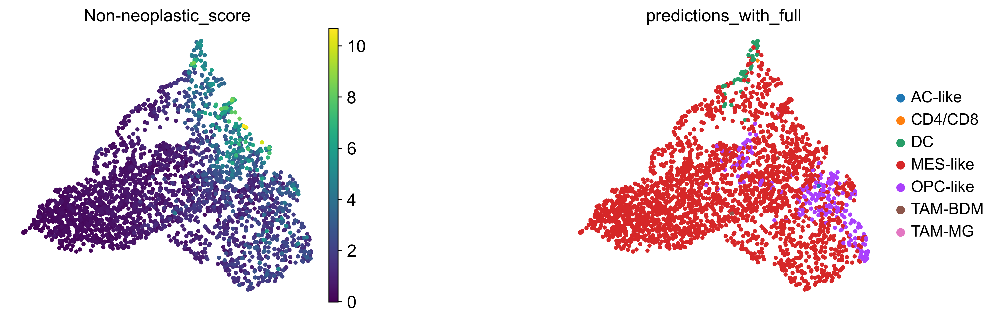

In [195]:
#plot original umap with scores
sc.pl.umap(target_adata_A_with_preds, color=['predictions_with_full'], wspace=0.6, ncols=3, frameon=False)

for cell_type in gene_sets.keys():
    sc.pl.umap(target_adata_A_with_preds, color=[f'{cell_type}_score',"predictions_with_full"], cmap='viridis', wspace=0.6, ncols=3, frameon=False)

/Users/carbs/Downloads/Spatial_Meta/scanpy/scanpy/plotting/_tools/scatterplots.py:401: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


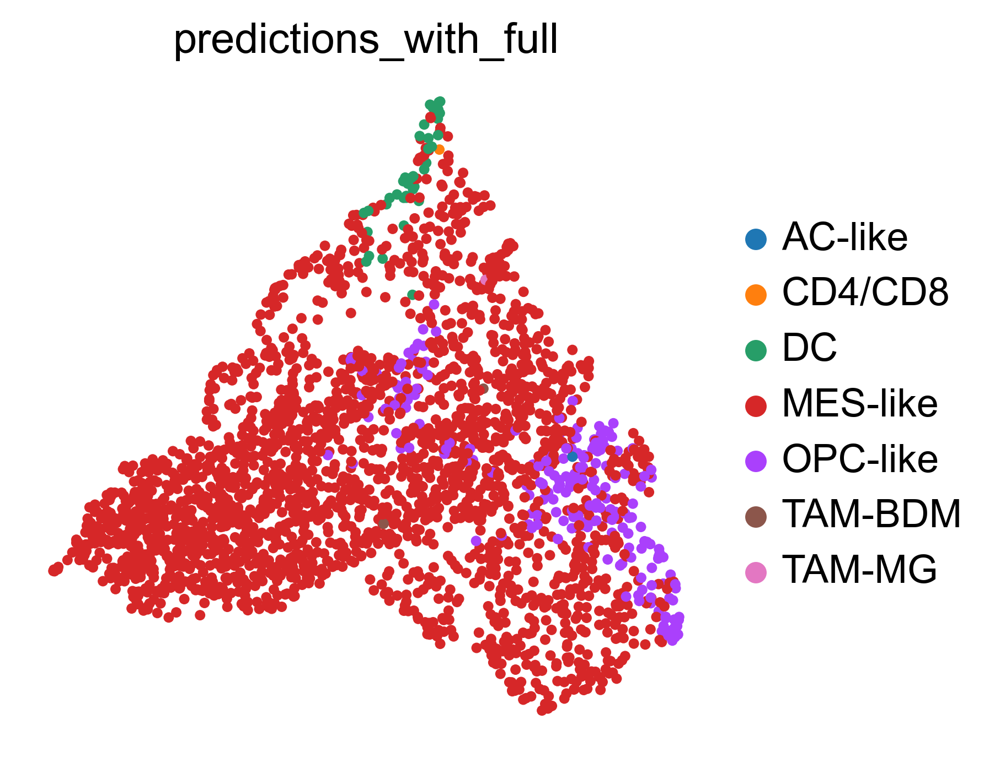

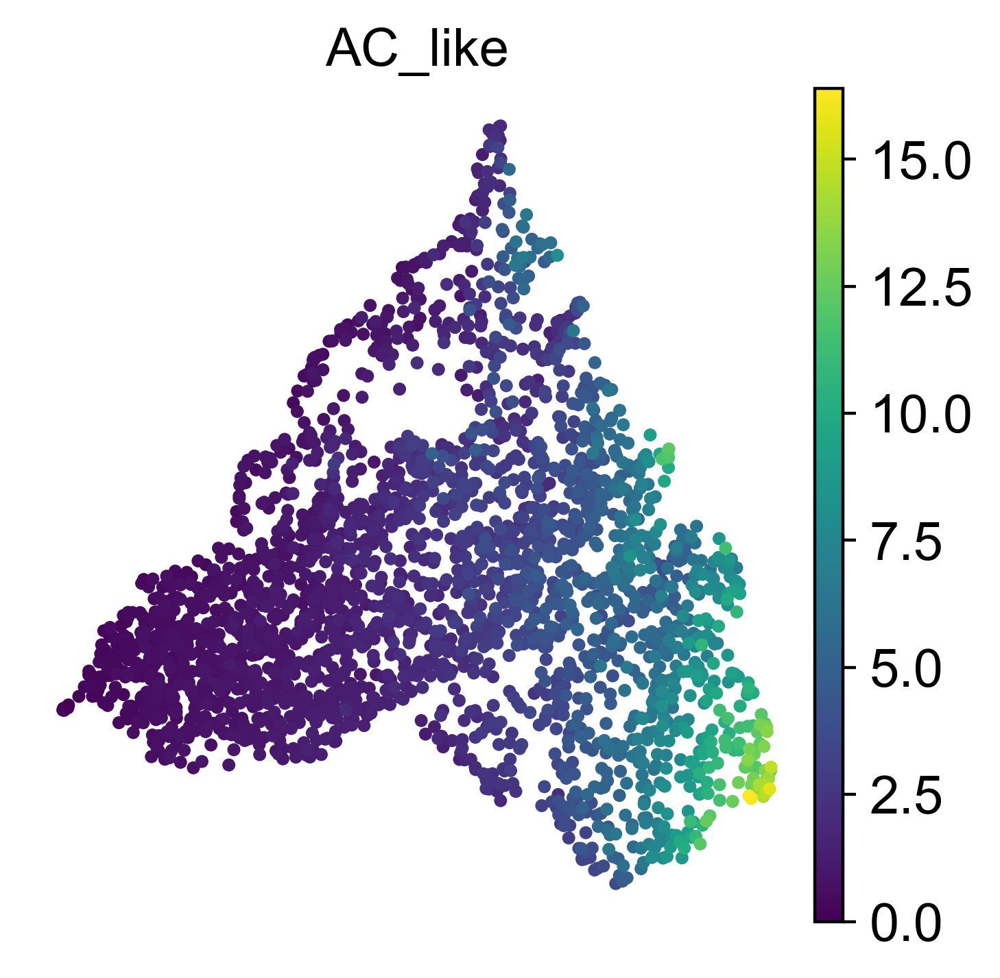

In [163]:
sc.pl.umap(target_adata_A_with_preds,
              frameon=False,
              wspace=0.6,
                  color=['predictions_with_full'],   
              )

#score genes

sc.tl.score_genes(target_adata_A_with_preds, AC_like, use_raw=False, score_name='AC_like')

#plot scores
sc.pl.umap(target_adata_A_with_preds,
              frameon=False,
              wspace=0.6,
                  color=['AC_like'],   
              )



In [140]:
target_adata_A_with_preds.obs['predictions_with_full'].value_counts()


predictions_with_full
MES-like    2313
OPC-like     208
DC            39
TAM-BDM        2
AC-like        1
CD4/CD8        1
TAM-MG         1
Name: count, dtype: int64